In [6]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torch.utils.data import DataLoader, Dataset
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import cross_val_predict
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.model_selection import KFold
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import RandomizedSearchCV
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import cross_val_predict
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.metrics import mean_absolute_error
from sklearn.metrics import mean_squared_error
from sklearn.metrics import r2_score
from sklearn.metrics import accuracy_score
from sklearn.metrics import confusion_matrix
from sklearn.metrics import classification_report
from sklearn.metrics import roc_auc_score
from sklearn.metrics import roc_curve
from sklearn.preprocessing import StandardScaler
import seaborn as sns
import wandb

ModuleNotFoundError: No module named 'wandb'

In [7]:
mydata = pd.read_csv('/Users/anastasia/Dropbox/regression_so_samples_allsbjs_fixed.csv')

In [8]:
pd.options.display.max_rows = 15

In [9]:
mydata

,Label,Sbj_ID,Age,ifCleanOnset,SleepStage,delta_power,theta_power,alpha_power,beta_power,gamma_power,...,FC_LocalSimple_mean3_stderr,Entropy_Rate_CTW,Entropy_Rate_LZ,Aperiodic_component,"Monophasic_vertices_count,","Biphasic_vertices_count,","Sleep_spindles_count,","K_complex_count,",O-information,S-information
0,30.0,2,83,0,0,-2.445233,-3.155950,-2.710832,-2.962410,-4.462281,...,0.336799,0.316177,0.316998,0.660012,0.0,0.0,2.000000,0.0,NaN,NaN
1,29.9,2,83,0,0,-3.324564,-3.857711,-3.775982,-4.076556,-5.188734,...,0.539413,0.515705,0.532923,0.645414,0.0,0.0,0.333333,0.0,-0.000281,0.010573
2,29.8,2,83,0,0,-2.219338,-2.767709,-2.312887,-3.297628,-4.449349,...,0.287693,0.305671,0.334226,0.720780,0.0,0.0,0.500000,0.0,NaN,NaN
3,29.7,2,83,0,0,-2.727042,-3.262588,-2.936053,-3.311534,-4.602471,...,0.328391,0.316754,0.310106,0.680707,0.0,0.0,1.000000,0.0,NaN,NaN
4,29.6,2,83,0,0,-2.480271,-2.864198,-2.560953,-3.247082,-4.445265,...,0.270287,0.285799,0.272204,0.673053,0.0,0.0,1.000000,0.0,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
175295,0.5,6811,79,1,1,-2.126810,-3.238122,-3.083983,-3.779917,-4.873306,...,0.132739,0.187623,0.148162,0.900491,0.0,0.0,0.500000,0.0,NaN,NaN
175296,0.4,6811,79,1,1,-4.225398,-6.021411,-6.309019,-7.301486,-9.633378,...,0.412933,0.448138,0.423812,1.977827,0.0,0.0,0.000000,0.0,-0.000735,0.254520
175297,0.3,6811,79,1,1,-2.096831,-3.002711,-3.164180,-3.704596,-4.731842,...,0.175018,0.184974,0.168836,0.948615,0.0,0.0,0.500000,0.0,NaN,NaN
175298,0.2,6811,79,1,1,-1.937574,-2.779680,-2.905882,-3.720251,-4.727719,...,0.163801,0.226120,0.182618,0.892886,0.0,0.0,1.000000,0.0,NaN,NaN


In [10]:
mydata.isnull().sum()

Label                            0
Sbj_ID                           0
Age                              0
ifCleanOnset                     0
SleepStage                       0
                             ...  
Biphasic_vertices_count,    105784
Sleep_spindles_count,       105784
K_complex_count,            105784
O-information               137816
S-information               137816
Length: 72, dtype: int64

In [11]:
# Show columns of the dataset
mydata.columns

Index(['Label', 'Sbj_ID', 'Age', 'ifCleanOnset', 'SleepStage', 'delta_power',
       'theta_power', 'alpha_power', 'beta_power', 'gamma_power',
       'Delta_to_theta_ratio', 'Delta_to_alpha_ratio', 'Delta_to_beta_ratio',
       'Delta_to_gamma_ratio', 'Theta_to_alpha_ratio', 'Theta_to_beta_ratio',
       'Theta_to_gamma_ratio', 'Alpha_to_beta_ratio', 'Alpha_to_gamma_ratio',
       'Beta_to_gamma_ratio', 'Transition_power_ratio',
       'Peak_delta_band_frequency', 'Peak_theta_band_frequency',
       'Peak_alpha_band_frequency', 'Peak_beta_band_frequency',
       'Peak_gamma_band_frequency', 'Temporal_coherence_delta_band',
       'Temporal_coherence_theta_band', 'Temporal_coherence_alpha_band',
       'Temporal_coherence_beta_band', 'Temporal_coherence_gamma_band',
       'Phase_amplitude_coupling_DT', 'Phase_amplitude_coupling_DA',
       'Phase_amplitude_coupling_DB', 'Phase_amplitude_coupling_DG',
       'Phase_amplitude_coupling_TA', 'Phase_amplitude_coupling_TB',
       'Phase_am

In [12]:
mydata['count'] = mydata.isnull().sum(axis=1) // 61

In [13]:
mydata

,Label,Sbj_ID,Age,ifCleanOnset,SleepStage,delta_power,theta_power,alpha_power,beta_power,gamma_power,...,Entropy_Rate_CTW,Entropy_Rate_LZ,Aperiodic_component,"Monophasic_vertices_count,","Biphasic_vertices_count,","Sleep_spindles_count,","K_complex_count,",O-information,S-information,count
0,30.0,2,83,0,0,-2.445233,-3.155950,-2.710832,-2.962410,-4.462281,...,0.316177,0.316998,0.660012,0.0,0.0,2.000000,0.0,NaN,NaN,0
1,29.9,2,83,0,0,-3.324564,-3.857711,-3.775982,-4.076556,-5.188734,...,0.515705,0.532923,0.645414,0.0,0.0,0.333333,0.0,-0.000281,0.010573,0
2,29.8,2,83,0,0,-2.219338,-2.767709,-2.312887,-3.297628,-4.449349,...,0.305671,0.334226,0.720780,0.0,0.0,0.500000,0.0,NaN,NaN,0
3,29.7,2,83,0,0,-2.727042,-3.262588,-2.936053,-3.311534,-4.602471,...,0.316754,0.310106,0.680707,0.0,0.0,1.000000,0.0,NaN,NaN,0
4,29.6,2,83,0,0,-2.480271,-2.864198,-2.560953,-3.247082,-4.445265,...,0.285799,0.272204,0.673053,0.0,0.0,1.000000,0.0,NaN,NaN,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
175295,0.5,6811,79,1,1,-2.126810,-3.238122,-3.083983,-3.779917,-4.873306,...,0.187623,0.148162,0.900491,0.0,0.0,0.500000,0.0,NaN,NaN,0
175296,0.4,6811,79,1,1,-4.225398,-6.021411,-6.309019,-7.301486,-9.633378,...,0.448138,0.423812,1.977827,0.0,0.0,0.000000,0.0,-0.000735,0.254520,0
175297,0.3,6811,79,1,1,-2.096831,-3.002711,-3.164180,-3.704596,-4.731842,...,0.184974,0.168836,0.948615,0.0,0.0,0.500000,0.0,NaN,NaN,0
175298,0.2,6811,79,1,1,-1.937574,-2.779680,-2.905882,-3.720251,-4.727719,...,0.226120,0.182618,0.892886,0.0,0.0,1.000000,0.0,NaN,NaN,0


In [14]:
mydata.isnull().sum()

Label                         0
Sbj_ID                        0
Age                           0
ifCleanOnset                  0
SleepStage                    0
                          ...  
Sleep_spindles_count,    105784
K_complex_count,         105784
O-information            137816
S-information            137816
count                         0
Length: 73, dtype: int64

In [15]:
mydata_disp = mydata[mydata['count'] > 0]
mydata_disp

,Label,Sbj_ID,Age,ifCleanOnset,SleepStage,delta_power,theta_power,alpha_power,beta_power,gamma_power,...,Entropy_Rate_CTW,Entropy_Rate_LZ,Aperiodic_component,"Monophasic_vertices_count,","Biphasic_vertices_count,","Sleep_spindles_count,","K_complex_count,",O-information,S-information,count
5,29.5,2,83,0,0,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1
8,29.2,2,83,0,0,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1
9,29.1,2,83,0,0,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1
10,29.0,2,83,0,0,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1
12,28.8,2,83,0,0,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
175280,2.0,6811,79,1,0,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1
175281,1.9,6811,79,1,0,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1
175282,1.8,6811,79,1,0,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1
175283,1.7,6811,79,1,0,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1


In [16]:
# Get the number of unique subjects 

mydata['Sbj_ID'].nunique()

668

In [17]:
# in each subject wiht NaNs, calculate the maximum number of consecutive NaNs (sum of rows of 'count' column)
# NaNs are consecutive if the 'Label' values between two rows are different for no more than 0.11
sbjs = mydata_disp['Sbj_ID'].unique()
max_consec_nans = []
all_consec_nans_per_sbj = {} # list of lists of consecutive NaNs for each subject
for num_sbj, sbj in enumerate(sbjs):
    consec_nan_for_sbj = []
    max_consec = 1
    consec_nan = []
    for i in range(len(mydata_disp[mydata_disp['Sbj_ID'] == sbj]) - 1):
        diff = abs(mydata_disp[mydata_disp['Sbj_ID'] == sbj].iloc[i]['Label'] - mydata_disp[mydata_disp['Sbj_ID'] == sbj].iloc[i+1]['Label'])
        if diff < 0.11:
            consec_nan.append(i)
            max_consec = max([len(consec_nan), max_consec])
        # if the difference between two consecutive labels is more than 0.11, they are not consecutive NaNs. Reset the list of consecutive NaNs
        else:
            if len(consec_nan) > 0:
                consec_nan_for_sbj.append(len(consec_nan))
                consec_nan = []
    max_consec_nans.append(max_consec)
    all_consec_nans_per_sbj[sbj] = consec_nan_for_sbj
max_consec_nans

    


[65,
 44,
 31,
 73,
 13,
 173,
 69,
 33,
 19,
 39,
 44,
 52,
 59,
 204,
 6,
 18,
 11,
 54,
 85,
 53,
 102,
 24,
 130,
 41,
 40,
 24,
 44,
 72,
 43,
 129,
 31,
 39,
 100,
 75,
 20,
 69,
 29,
 61,
 159,
 31,
 48,
 3,
 18,
 21,
 86,
 35,
 16,
 58,
 119,
 6,
 36,
 20,
 84,
 27,
 34,
 67,
 46,
 44,
 39,
 71,
 34,
 40,
 79,
 35,
 45,
 80,
 45,
 67,
 4,
 80,
 6,
 29,
 4,
 1,
 25,
 49,
 58,
 113,
 1,
 59,
 74,
 6,
 15,
 60,
 52,
 70,
 170,
 19,
 13,
 16,
 70,
 234,
 110,
 24,
 16,
 29,
 54,
 78,
 44,
 89,
 69,
 66,
 120,
 9,
 136,
 43,
 84,
 95,
 25,
 7,
 83,
 21,
 9,
 60,
 5,
 224,
 54,
 24,
 64,
 24,
 15,
 10,
 66,
 116,
 47,
 33,
 45,
 151,
 90,
 72,
 44,
 24,
 11,
 60,
 65,
 37,
 171,
 44,
 11,
 11,
 1,
 1,
 9,
 28,
 79,
 50,
 76,
 13,
 17,
 27,
 12,
 76,
 21,
 17,
 20,
 19,
 59,
 49,
 64,
 40,
 17,
 14,
 15,
 139,
 124,
 21,
 91,
 49,
 64,
 76,
 146,
 127,
 61,
 37,
 69,
 42,
 53,
 55,
 83,
 11,
 36,
 54,
 41,
 98,
 20,
 155,
 19,
 112,
 20,
 24,
 29,
 13,
 14,
 19,
 19,
 54,
 4,
 30,
 58

In [19]:
# for each subject in the dictionary, sort the list of consecutive NaNs in descending order
for sbj in all_consec_nans_per_sbj:
    all_consec_nans_per_sbj[sbj].sort(reverse=True)

all_consec_nans_per_sbj

{2: [65,
  16,
  16,
  10,
  5,
  5,
  5,
  5,
  5,
  4,
  3,
  3,
  2,
  2,
  2,
  2,
  2,
  2,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1],
 6: [44, 14, 13, 10, 10, 10, 8, 5, 4, 2, 2, 1, 1, 1, 1],
 10: [31,
  7,
  4,
  4,
  3,
  3,
  3,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1],
 12: [73, 26, 21, 17, 10, 6, 5, 5, 4, 3, 3, 3, 3, 2, 2, 2, 2, 2, 1, 1],
 35: [7,
  6,
  6,
  5,
  5,
  5,
  5,
  5,
  5,
  4,
  4,
  4,
  3,
  3,
  3,
  2,
  2,
  2,
  2,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1],
 54: [173, 8, 5, 4, 3, 3, 2, 1],
 56: [69, 41, 29, 25, 10, 9, 5, 1, 1, 1, 1],
 77: [33,
  25,
  24,
  10,
  9,
  9,
  7,
  7,
  4,
  4,
  4,
  3,
  3,
  3,
  3,
  2,
  2,
  2,
  2,
  1,
  1,
  1,
  1,
  1,
  1,
  1],
 99: [19, 14, 14, 9, 9, 6, 5, 5, 5, 4, 4, 4, 4, 2, 2, 1, 1, 1, 1, 1, 1],
 105: [39, 25, 19, 17, 16, 6, 6, 4, 4, 2, 1, 1, 1],
 107: [44, 19, 19, 8, 5, 4, 4, 4, 2, 2, 1, 1, 1, 1, 1, 1, 1, 1, 1],
 110: [

In [20]:
# Write a function to display the subjects for a chosen feature

import random
#
def show_feature_for_ransom_subjects(mydata, feature_name, num_sbjs, random_seed = 42):
    counter = 0
    subjects = mydata['Sbj_ID'].unique()
    random.seed(random_seed)
    random.shuffle(subjects)
    for i in subjects:
        counter = counter + 1
        if counter < num_sbjs:
            print('Sbj ID: ', i)
            # Also show Nans in the plot
        
            sns.pairplot(mydata[mydata['Sbj_ID'] == i], x_vars=['Label'], y_vars=[feature_name], height=5, aspect=1, kind='reg')
            
            plt.show()
        else:
            continue


Sbj ID:  3399


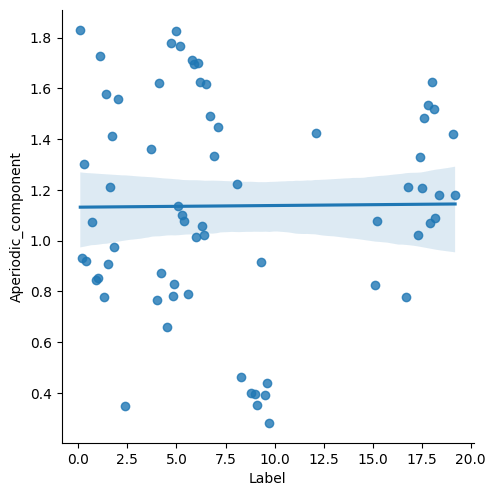

Sbj ID:  2887


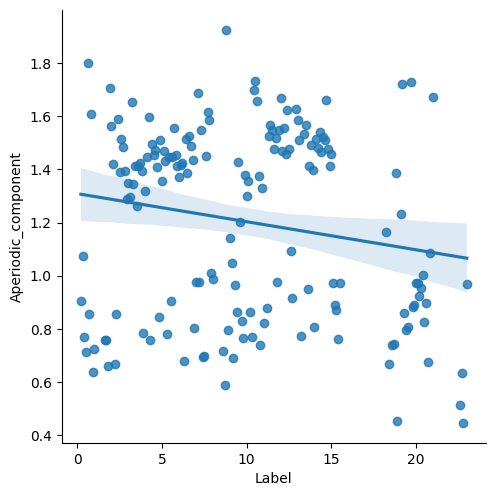

Sbj ID:  6351


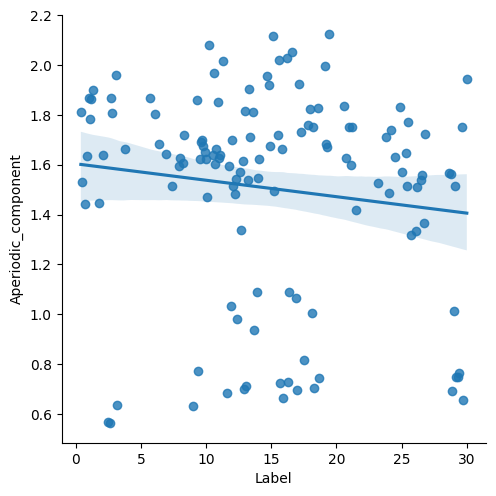

Sbj ID:  1256


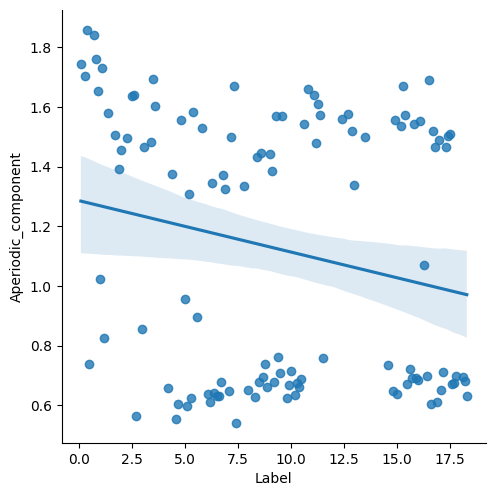

In [21]:
# Try it on the 'Aperiodic_component' feature
show_feature_for_ransom_subjects(mydata, 'Aperiodic_component', 5)

Sbj ID:  3399


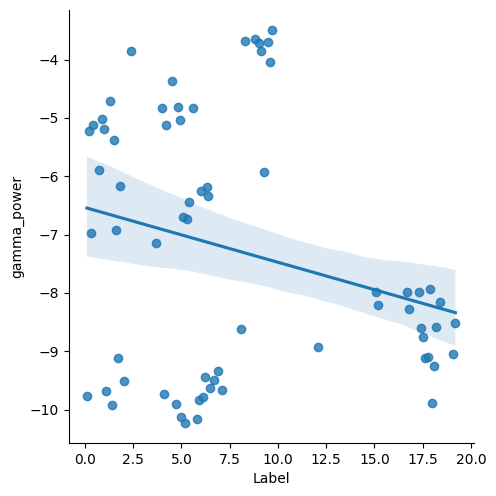

Sbj ID:  2887


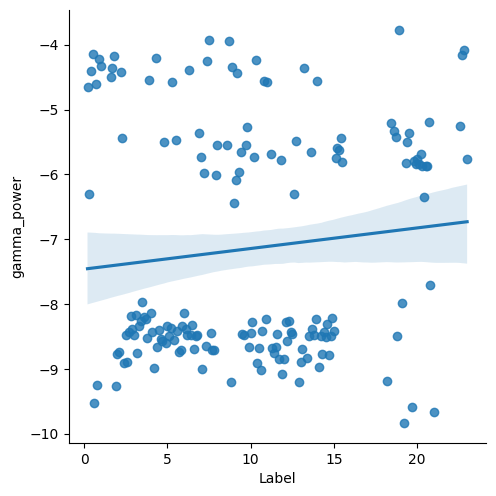

Sbj ID:  6351


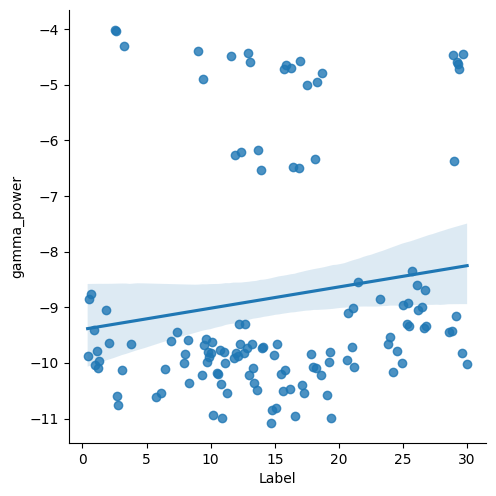

Sbj ID:  1256


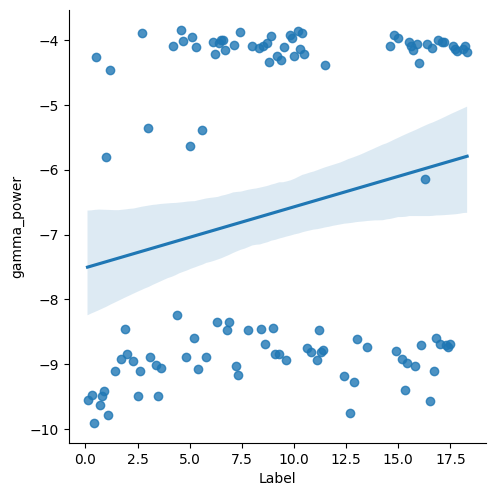

Sbj ID:  4888


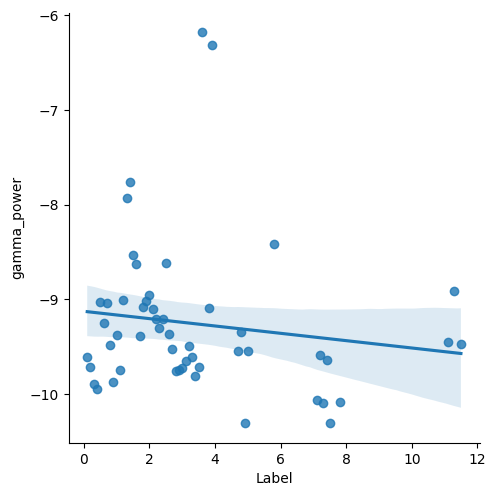

Sbj ID:  3021


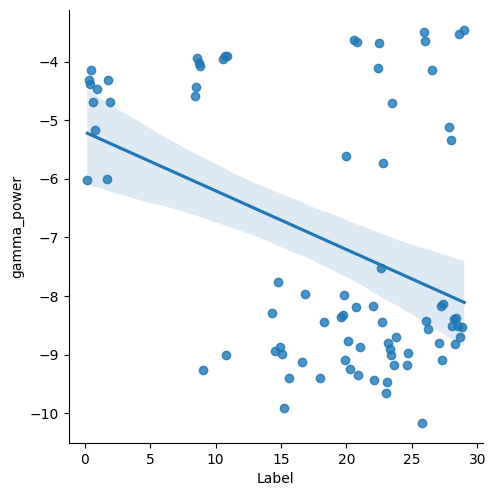

Sbj ID:  4715


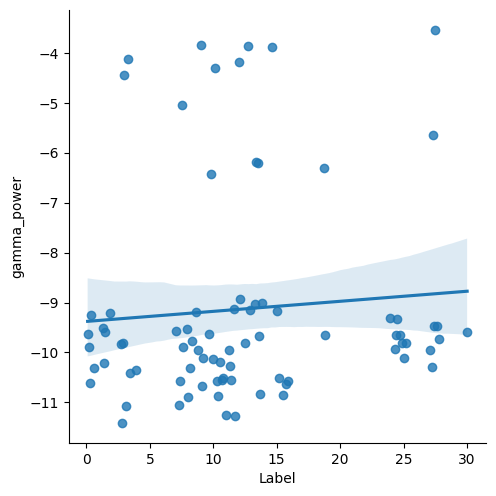

Sbj ID:  3267


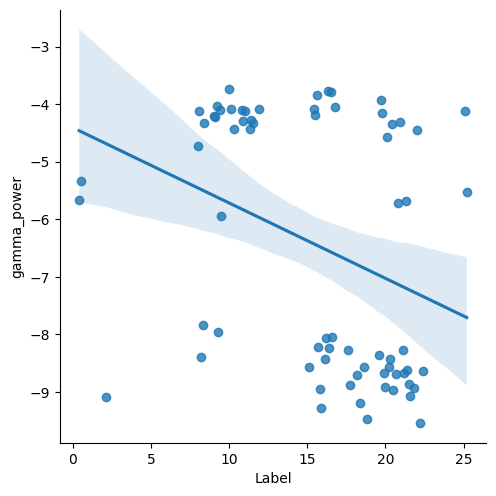

Sbj ID:  10


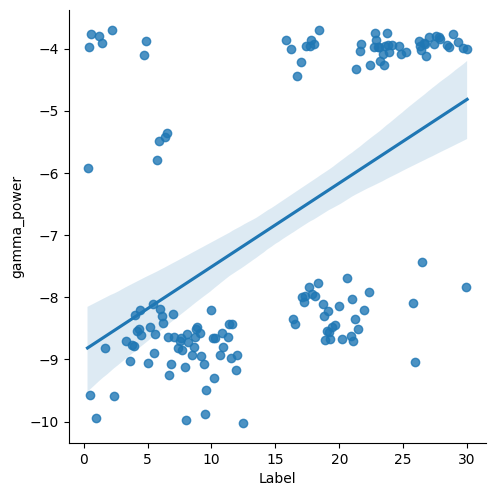

In [22]:
# Try it on the 'Aperiodic_component' feature
show_feature_for_ransom_subjects(mydata, 'gamma_power', 10)

Sbj ID:  3399


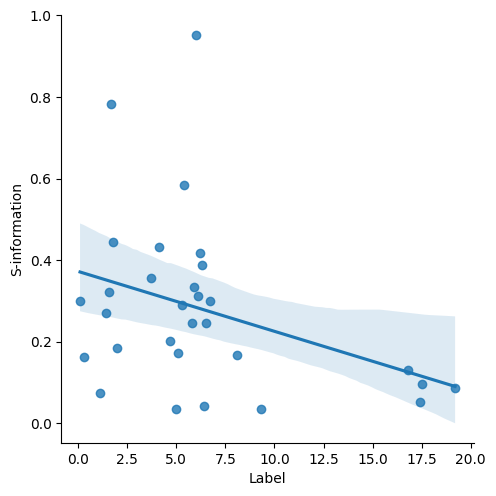

Sbj ID:  2887


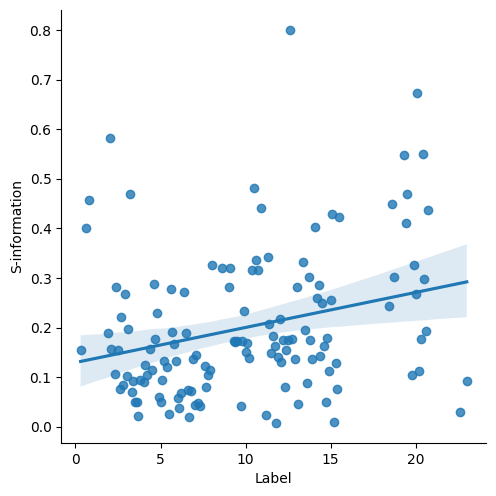

Sbj ID:  6351


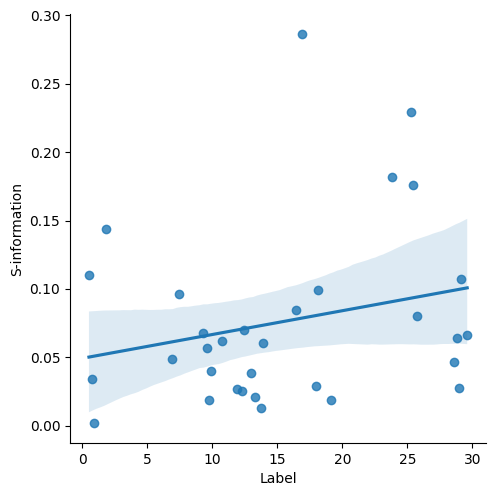

Sbj ID:  1256


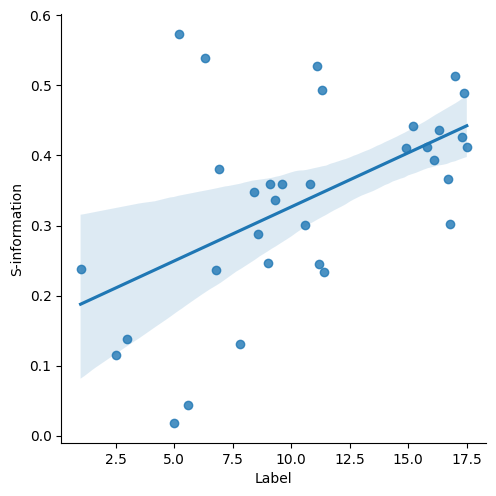

Sbj ID:  4888


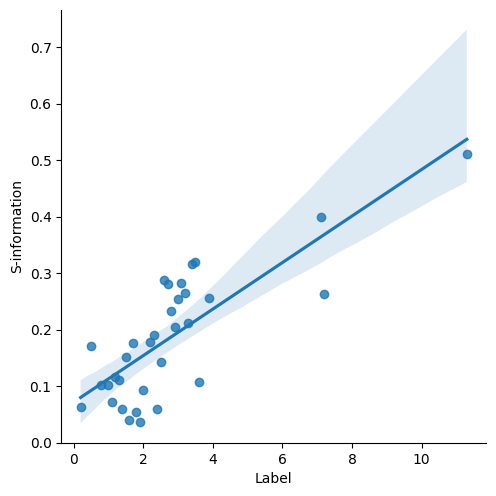

Sbj ID:  3021


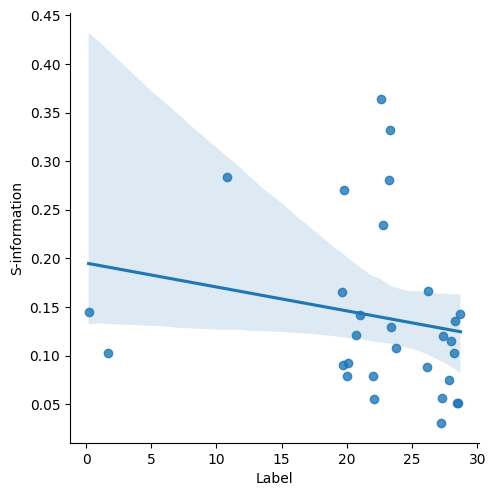

Sbj ID:  4715


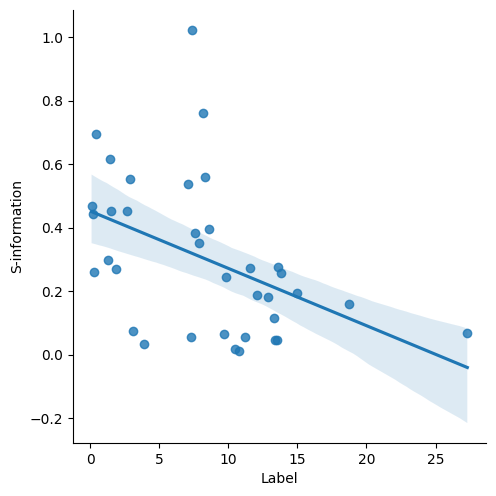

Sbj ID:  3267


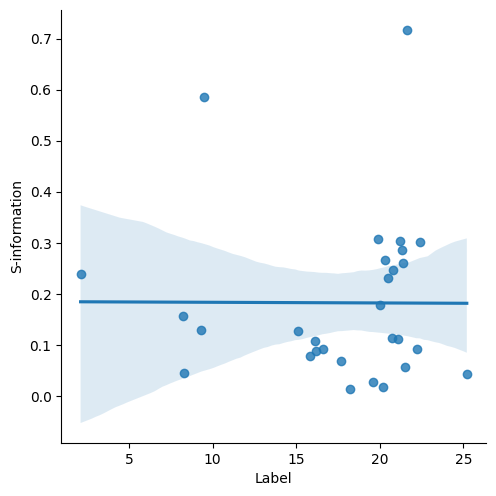

Sbj ID:  10


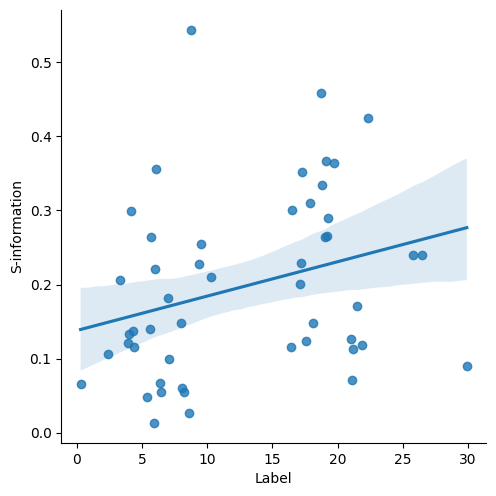

In [24]:
# Try it on the 'S-information' feature
show_feature_for_ransom_subjects(mydata, 'S-information', 10)

In [18]:
# drop all the rows with NaNs
mydata_no_nan = mydata.dropna()

In [19]:
mydata_no_nan

,Label,Sbj_ID,Age,ifCleanOnset,SleepStage,delta_power,theta_power,alpha_power,beta_power,gamma_power,...,Entropy_Rate_CTW,Entropy_Rate_LZ,Aperiodic_component,"Monophasic_vertices_count,","Biphasic_vertices_count,","Sleep_spindles_count,","K_complex_count,",O-information,S-information,count
1,29.9,2,83,0,0,-3.324564,-3.857711,-3.775982,-4.076556,-5.188734,...,0.515705,0.532923,0.645414,0.0,0.0,0.333333,0.0,-0.000281,0.010573,0
6,29.4,2,83,0,0,-4.848356,-5.818253,-5.394159,-5.888045,-8.615530,...,0.605375,0.633995,1.284077,0.0,0.0,2.000000,0.0,-0.006095,0.146756,0
31,26.9,2,83,0,0,-4.924886,-5.905016,-6.044935,-6.545319,-8.208605,...,0.711738,0.737364,1.218917,0.0,0.0,2.000000,0.0,-0.003422,0.150840,0
32,26.8,2,83,0,0,-5.468501,-6.205310,-6.098623,-6.720252,-8.857843,...,0.591506,0.596093,1.300584,0.0,0.0,1.000000,0.0,0.012917,0.248064,0
56,24.4,2,83,0,0,-4.741512,-5.474530,-4.672525,-5.941589,-8.613637,...,0.643544,0.665006,1.317338,0.0,0.0,2.000000,0.0,0.000381,0.203989,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
175290,1.0,6811,79,1,1,-4.612309,-5.701384,-5.750999,-7.129704,-9.228588,...,0.515748,0.516844,1.829361,0.0,0.0,0.000000,0.0,-0.076139,0.694356,0
175291,0.9,6811,79,1,1,-4.581372,-5.953251,-6.001528,-7.546534,-9.538596,...,0.472460,0.459417,1.798721,0.0,0.0,0.000000,0.0,0.009383,0.143544,0
175292,0.8,6811,79,1,1,-3.978263,-5.642021,-5.366267,-7.584956,-9.451683,...,0.470639,0.447931,1.895815,0.0,0.0,0.000000,0.0,-0.082312,0.625039,0
175293,0.7,6811,79,1,1,-4.693986,-6.158447,-5.287016,-6.749484,-9.173452,...,0.414871,0.403138,1.718388,0.0,0.0,0.000000,0.0,-0.056656,0.633119,0


## Assess correlation between time to sleep onset and other variables ##


In [28]:

# Find correlation between variables

mydata_no_nan.corr()


,Label,Sbj_ID,Age,ifCleanOnset,SleepStage,delta_power,theta_power,alpha_power,beta_power,gamma_power,...,Entropy_Rate_CTW,Entropy_Rate_LZ,Aperiodic_component,"Monophasic_vertices_count,","Biphasic_vertices_count,","Sleep_spindles_count,","K_complex_count,",O-information,S-information,count
Label,1.000000,0.062586,-0.059972,-0.038294,-0.307872,-0.035439,-0.063090,-0.049363,0.057247,0.105965,...,0.243242,0.243382,-0.202611,NaN,NaN,0.050843,NaN,-0.006254,-0.043389,NaN
Sbj_ID,0.062586,1.000000,0.024450,-0.015161,-0.006361,-0.013683,-0.015905,-0.027804,-0.004058,-0.000271,...,0.036569,0.036672,-0.003396,NaN,NaN,-0.003533,NaN,-0.002624,-0.012289,NaN
Age,-0.059972,0.024450,1.000000,-0.013503,0.016765,-0.078538,-0.005320,0.026882,-0.035948,-0.033165,...,0.024303,0.031740,0.004152,NaN,NaN,-0.001355,NaN,0.014354,-0.041400,NaN
ifCleanOnset,-0.038294,-0.015161,-0.013503,1.000000,-0.120127,0.010003,0.030022,0.007402,0.037280,0.057217,...,0.042901,0.045224,-0.056585,NaN,NaN,-0.013965,NaN,0.005877,-0.034573,NaN
SleepStage,-0.307872,-0.006361,0.016765,-0.120127,1.000000,0.166491,0.086725,-0.048180,-0.093144,-0.085320,...,-0.244253,-0.239615,0.205941,NaN,NaN,-0.096646,NaN,-0.007308,0.056276,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
"Sleep_spindles_count,",0.050843,-0.003533,-0.001355,-0.013965,-0.096646,-0.183450,-0.240957,0.024743,0.030147,-0.091125,...,0.156045,0.150851,0.016732,NaN,NaN,1.000000,NaN,0.002487,-0.015867,NaN
"K_complex_count,",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
O-information,-0.006254,-0.002624,0.014354,0.005877,-0.007308,0.029772,0.019228,0.016960,0.043565,0.045895,...,-0.054530,-0.071266,-0.037783,NaN,NaN,0.002487,NaN,1.000000,0.060136,NaN
S-information,-0.043389,-0.012289,-0.041400,-0.034573,0.056276,-0.040250,-0.105714,-0.107942,-0.173896,-0.139422,...,-0.181312,-0.230891,0.143396,NaN,NaN,-0.015867,NaN,0.060136,1.000000,NaN


In [31]:
# Find the most correlated variables

mydata_no_nan.corr().unstack().sort_values().drop_duplicates()

SP_Summaries_welch_rect_area_5_1  gamma_power                   -0.954127
Aperiodic_component               gamma_power                   -0.891490
gamma_power                       Beta_to_gamma_ratio           -0.846149
MD_hrv_classic_pnn40              theta_power                   -0.843884
SB_BinaryStats_diff_longstretch0  gamma_power                   -0.829225
                                                                   ...   
Phase_amplitude_coupling_DT       Phase_amplitude_coupling_TG    0.969878
Entropy_Rate_CTW                  Entropy_Rate_LZ                0.980559
Phase_amplitude_coupling_DB       Phase_amplitude_coupling_TG    0.984937
Label                             Label                          1.000000
                                  Monophasic_vertices_count,          NaN
Length: 2348, dtype: float64

In [32]:
# Find the most correlated variables with the target variable (Label) but exclude the results that have NaN values and the results that are equal to 1

mydata_no_nan.corr()['Label'].sort_values().dropna().drop_duplicates()


SleepStage                             -0.307872
CO_HistogramAMI_even_2_5               -0.249937
CO_Embed2_Dist_tau_d_expfit_meandiff   -0.241459
Alpha_to_gamma_ratio                   -0.205430
Aperiodic_component                    -0.202611
                                          ...   
SP_Summaries_welch_rect_centroid        0.156444
FC_LocalSimple_mean3_stderr             0.218928
Entropy_Rate_CTW                        0.243242
Entropy_Rate_LZ                         0.243382
Label                                   1.000000
Name: Label, Length: 69, dtype: float64

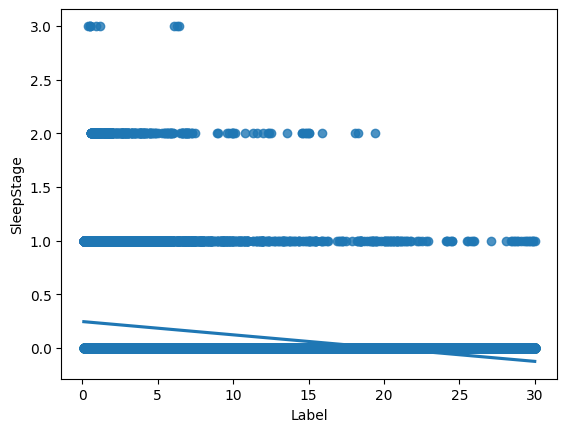

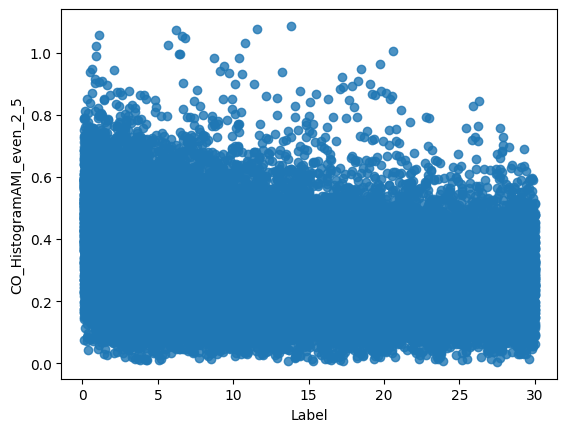

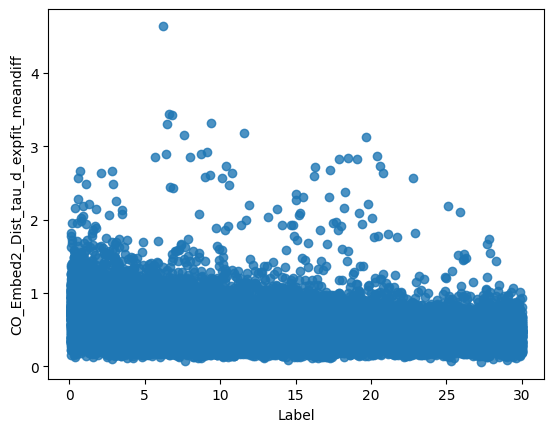

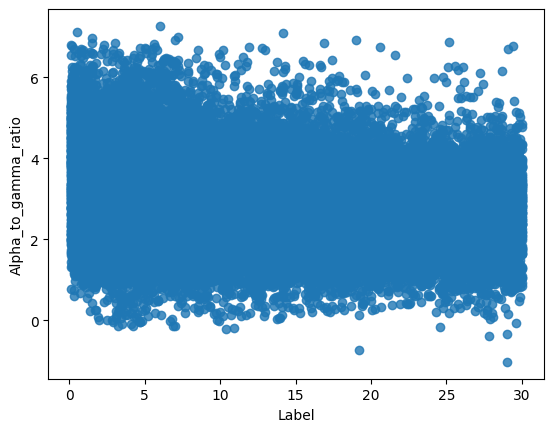

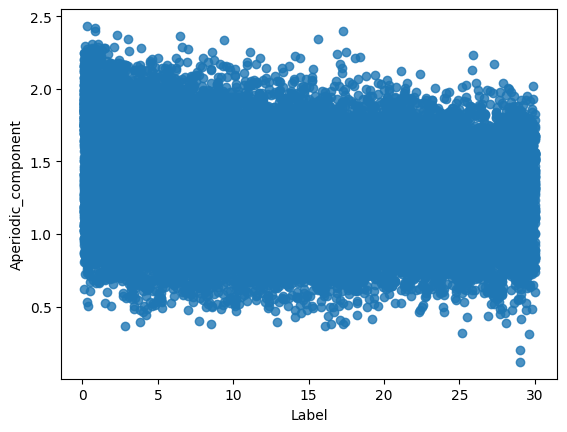

...

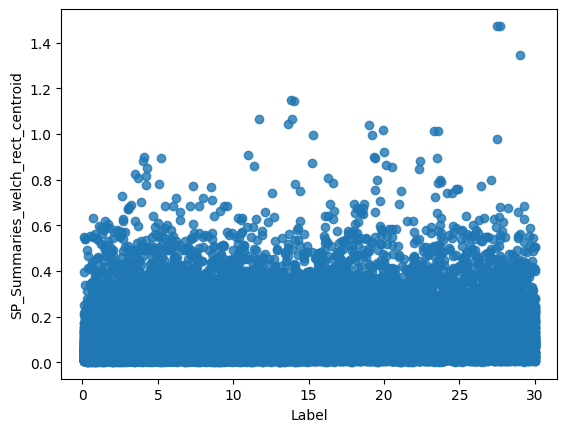

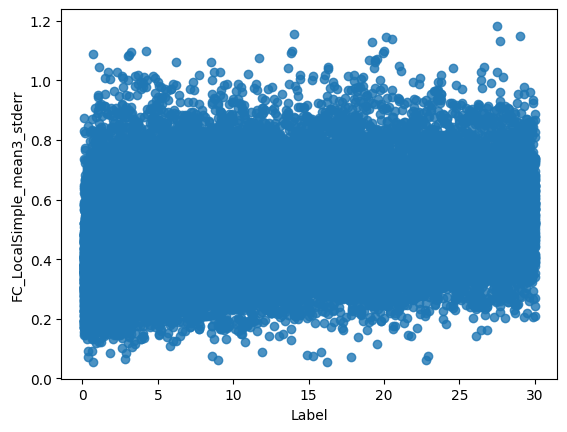

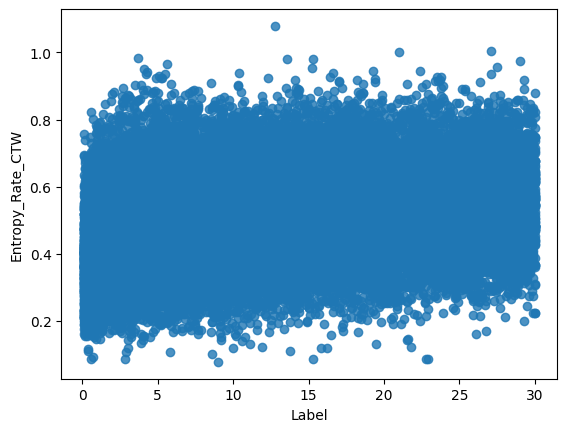

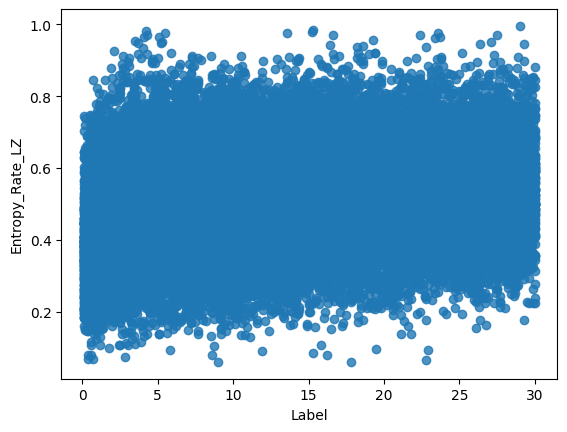

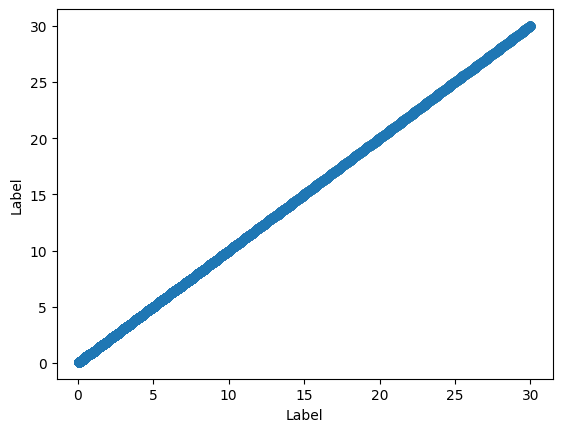

In [33]:
# Make plots the correlation between the Label and most correlated variables for each variable

import matplotlib.pyplot as plt
import seaborn as sns

for i in mydata_no_nan.corr()['Label'].sort_values().dropna().drop_duplicates().index[0:]:
    sns.regplot(x= "Label", y=i, data=mydata_no_nan)
    plt.show()

In [31]:
# Plot the correlation of top 20 correlated and anticorrelated variables with the target variable (Label)

import seaborn as sns

corr = mydata.corr()
corr_target = abs(corr["Label"])
relevant_features = corr_target[corr_target>0.10]
relevant_features.sort_values(ascending=False)

top_20 = relevant_features.sort_values(ascending=False).head(30)

top_20


Label                                   1.000000
SleepStage                              0.305491
CO_HistogramAMI_even_2_5                0.231021
CO_Embed2_Dist_tau_d_expfit_meandiff    0.227703
Alpha_to_gamma_ratio                    0.187338
                                          ...   
Alpha_to_beta_ratio                     0.127677
Delta_to_beta_ratio                     0.109318
gamma_power                             0.105754
SP_Summaries_welch_rect_centroid        0.105074
SP_Summaries_welch_rect_area_5_1        0.101270
Name: Label, Length: 21, dtype: float64

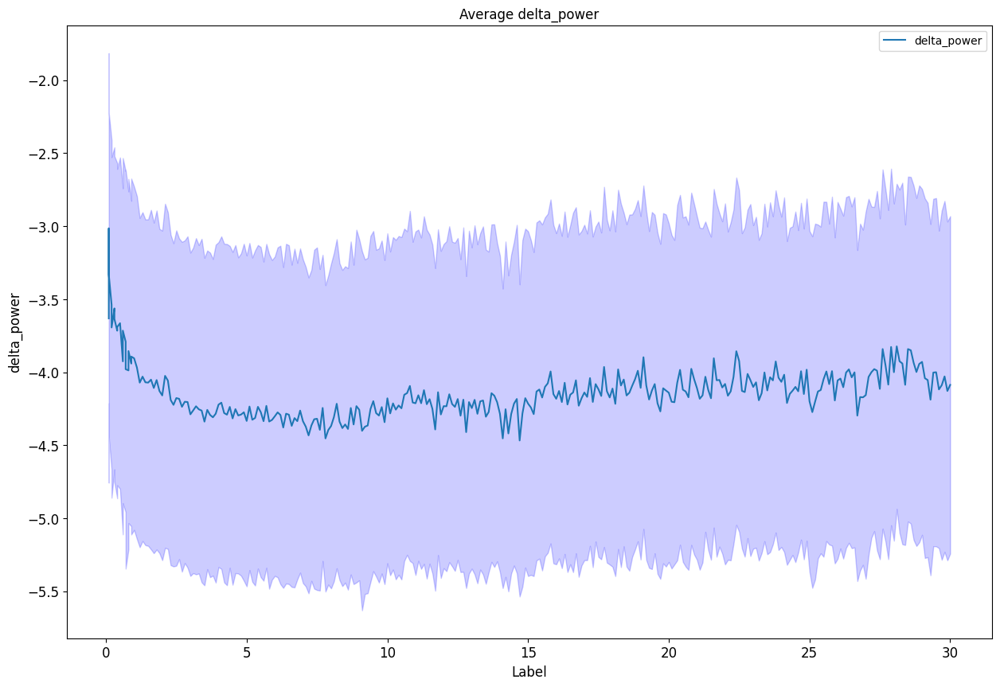

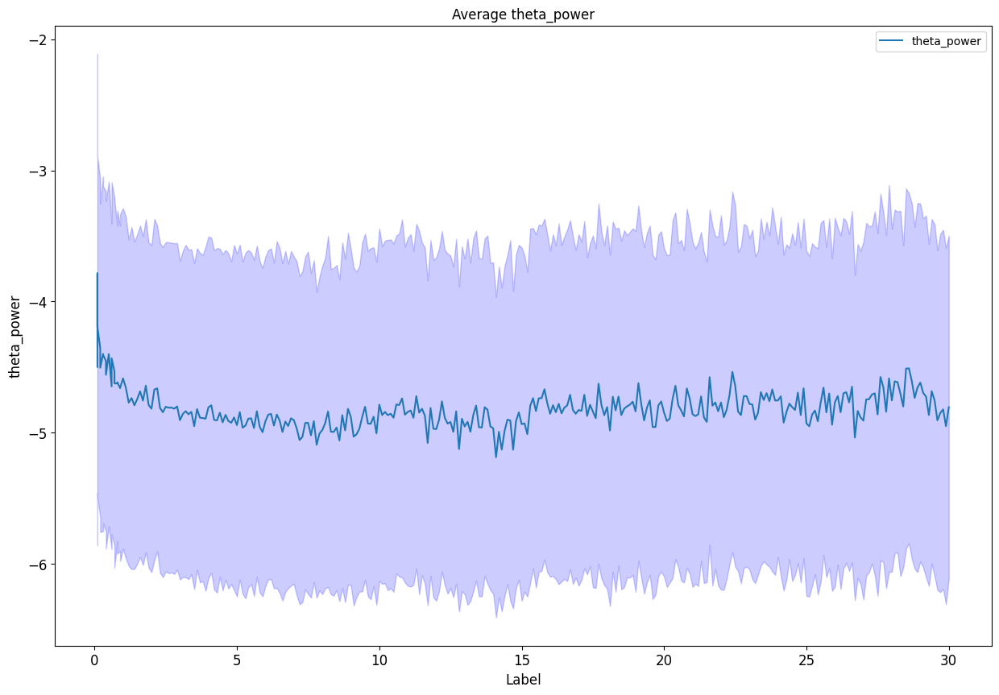

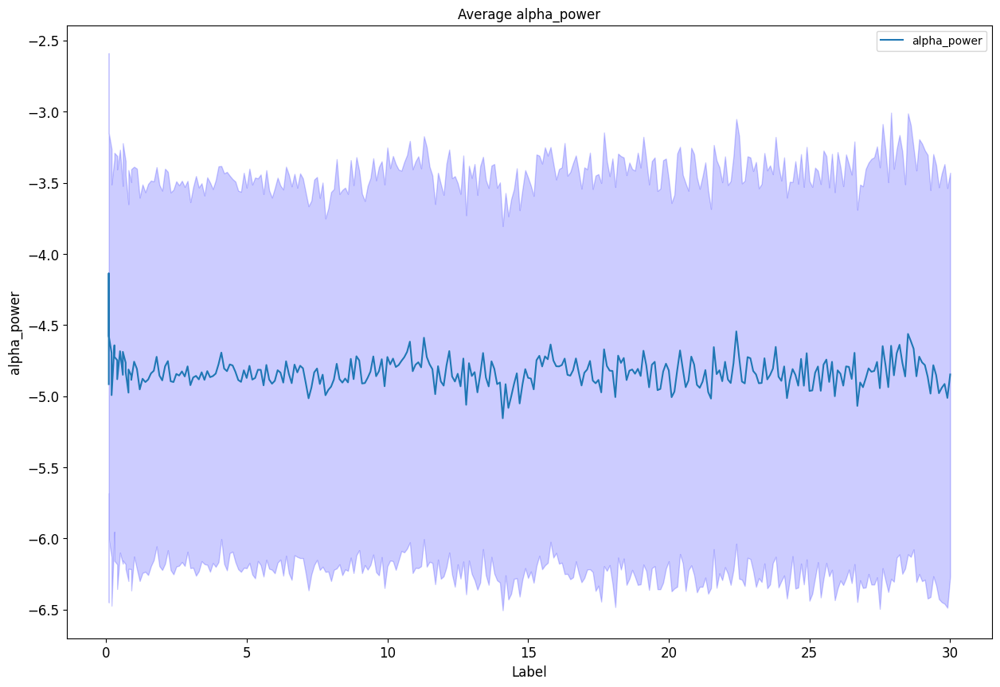

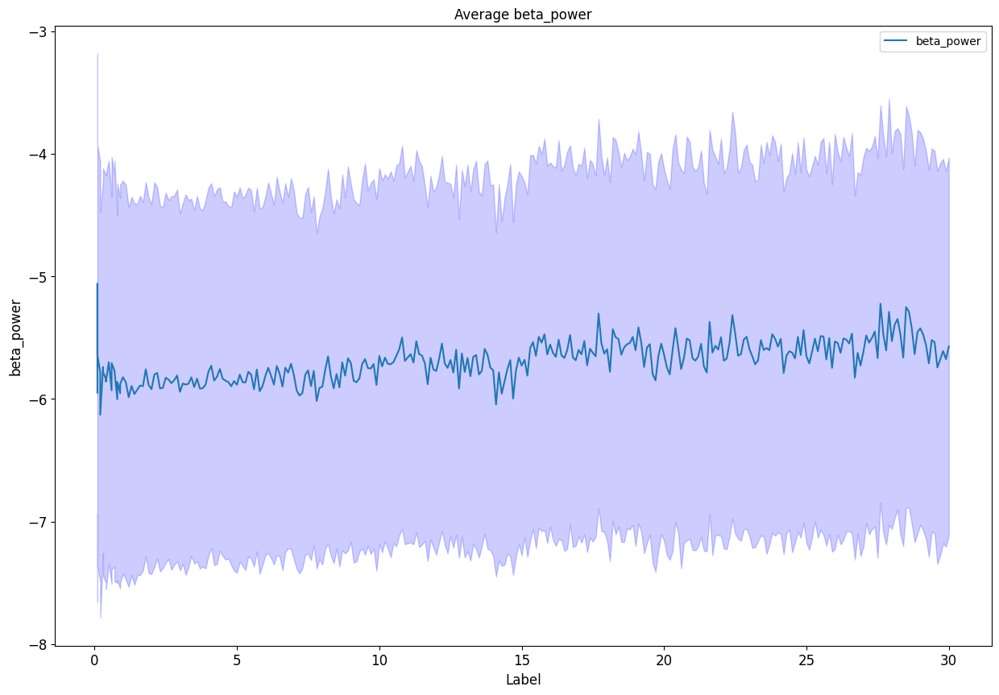

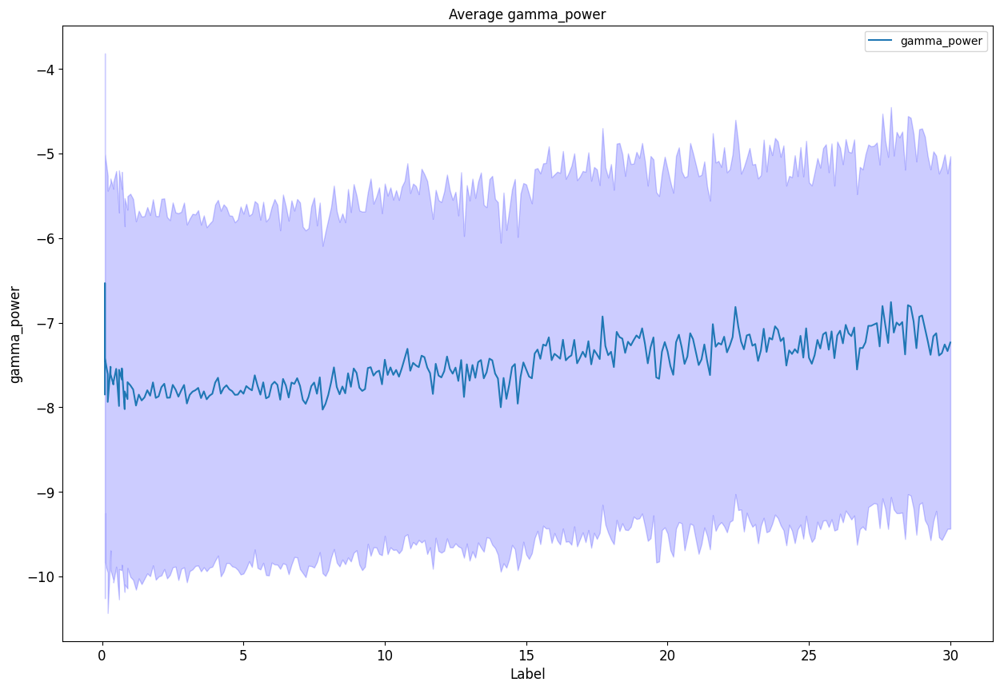

...

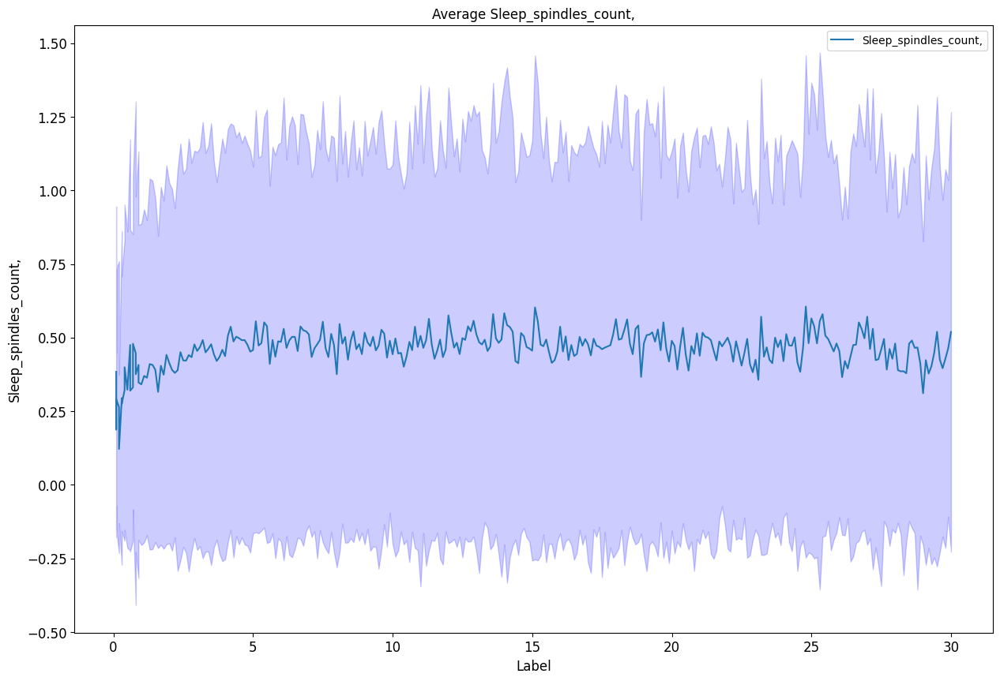

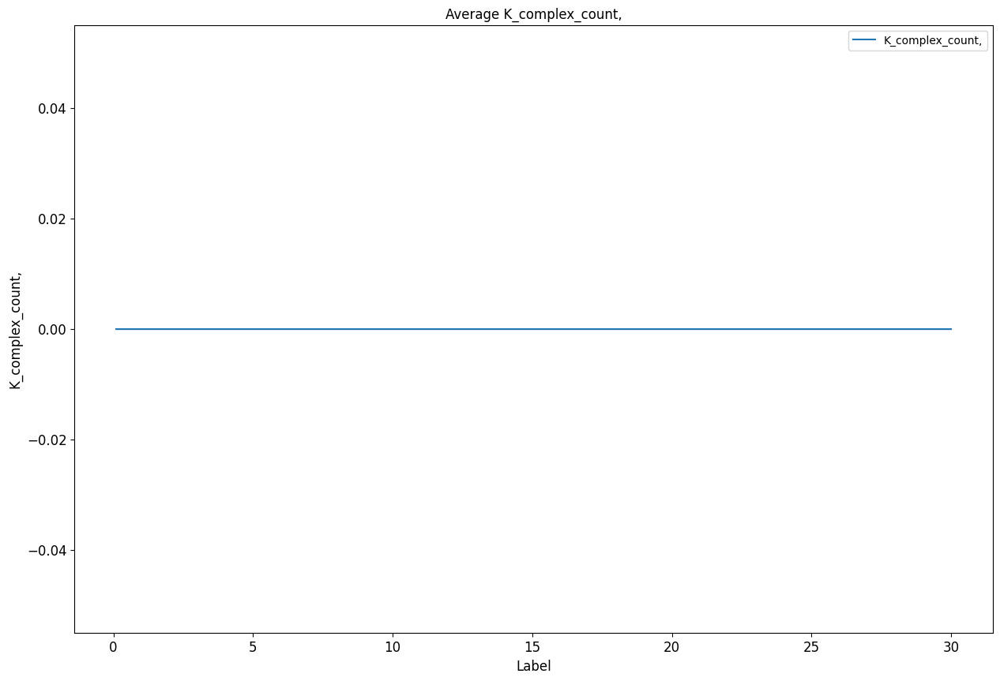

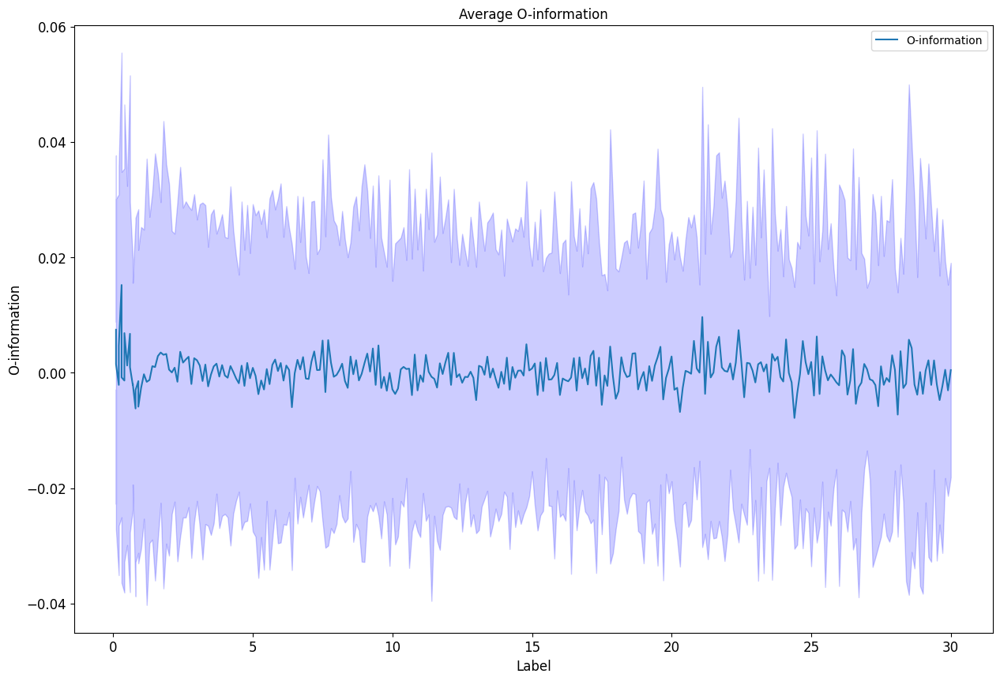

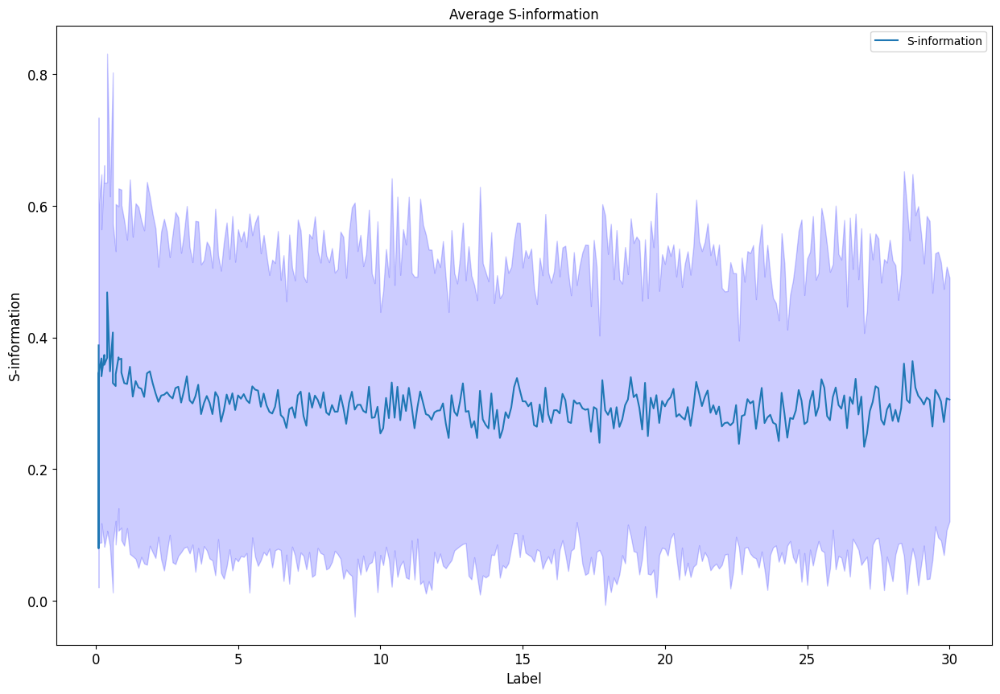

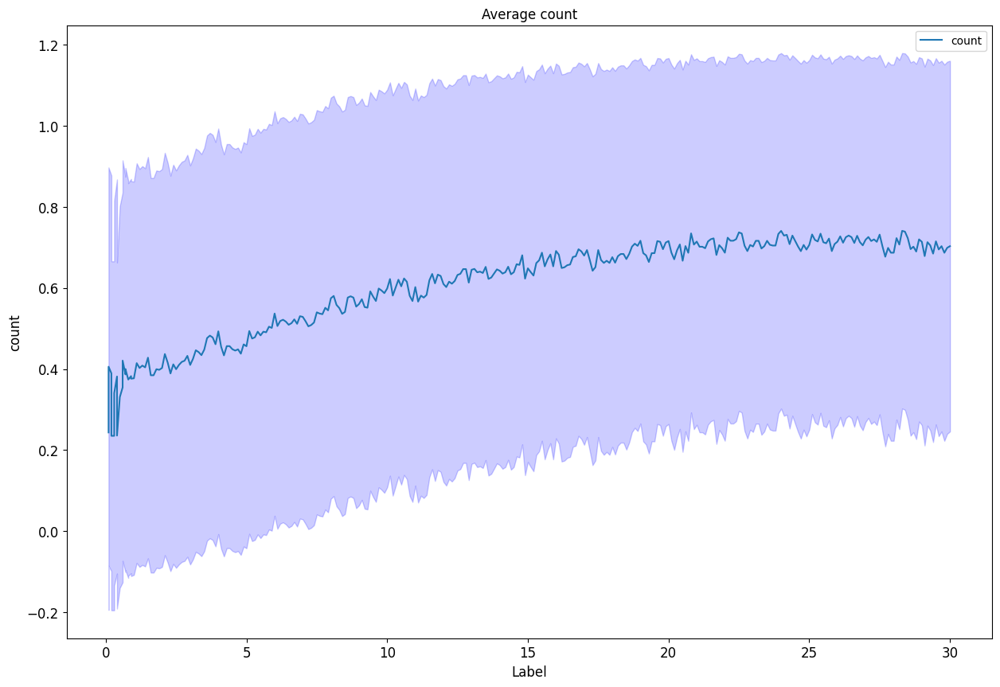

In [34]:
# For all features plot how their values change with the decreasing target variable (Label) (average + std)

labels = mydata['Label'].unique()
labels.sort()

for i in mydata.columns[4:]:
    # exclude SleepStage
    if i == 'SleepStage':
        continue
    average = mydata.groupby('Label')[i].mean()
    std = mydata.groupby('Label')[i].std()
    plot = average.plot(title='Average ' + i, figsize=(15, 10), legend=True, fontsize=12)
    plot.fill_between(labels, average - std, average + std, color='b', alpha=0.2)
    plot.set_xlabel('Label', fontsize=12)
    plot.set_ylabel(i, fontsize=12)
    plt.show()

<Axes: >

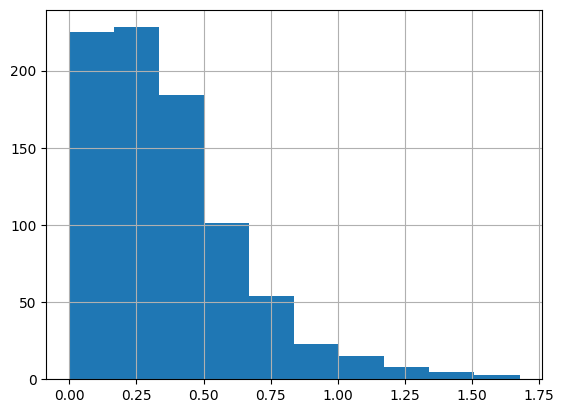

In [35]:
# Look at distribution of S-information for Labels < 0.5 

mydata[mydata['Label'] < 0.5]['S-information'].hist()

<Axes: >

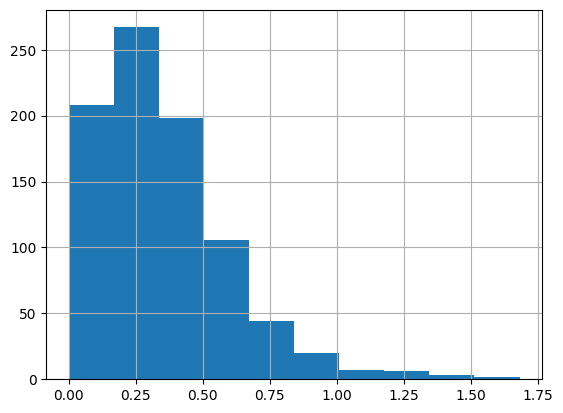

In [37]:
# Look at distribution of S-information for 1 >Labels > 0.5 

mydata[(mydata['Label'] < 1) & (mydata['Label'] > 0.5)]['S-information'].hist()

<Axes: >

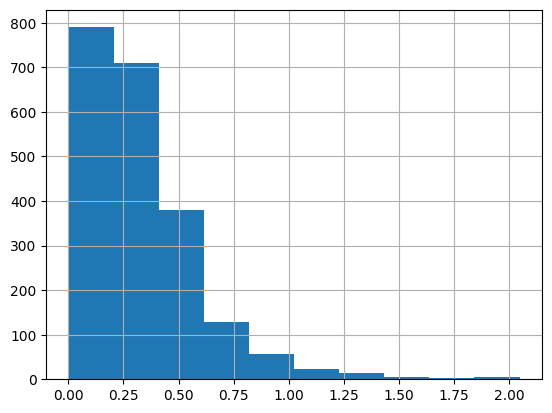

In [36]:
# Look at distribution of S-information for 2 >Labels > 1

mydata[(mydata['Label'] < 2) & (mydata['Label'] > 1)]['S-information'].hist()

In [39]:
# drop all the rows with NaNs
mydata_no_nan = mydata.dropna()

# Regression from single feature veactor of extracted EEG period 

In [20]:

import pandas as pd
import numpy as np
import sklearn
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import train_test_split
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import cross_val_predict

In [21]:

def train_test_split_sbjs(mydata_no_nan, test_size = 0.2, random_seed = 42):
 
    # assert that the data has no NaNs
    assert mydata_no_nan.isnull().sum().sum() == 0, 'There are NaNs in the data'
    
    # get the unique subjects
    unique_subjects = mydata_no_nan['Sbj_ID'].unique()

    # define the train size
    train_size = 1 - test_size

    # define the number of subjects in the test set

    test_size_subjects = int(test_size * len(unique_subjects))

    # Select the unique subjects for the test set

    test_subjects = random.sample(list(unique_subjects), test_size_subjects)

    # Select the unique subjects for the training set
    train_subjects = [x for x in unique_subjects if x not in test_subjects]

    # Create the test and training sets
    test_set = mydata_no_nan[mydata_no_nan['Sbj_ID'].isin(test_subjects)]
    train_set = mydata_no_nan[mydata_no_nan['Sbj_ID'].isin(train_subjects)]

    # Create X and y from dataframes to use in scikit-learn (drop Label, SleepStage, Sbj_ID and ifCleanOnset columns)

    X_train = train_set.drop(['Label', 'SleepStage', 'Sbj_ID', 'ifCleanOnset'], axis=1)
    y_train = train_set['Label']
    X_test = test_set.drop(['Label', 'SleepStage', 'Sbj_ID', 'ifCleanOnset'], axis=1)
    y_test = test_set['Label']

    return X_train, y_train, X_test, y_test

In [23]:
import matplotlib.pyplot as plt

# Create a function for plotting the sorted feature importances in a long horizontal bar chart and increased font size

def plot_feature_importances(model, X):
    importances = model.feature_importances_
    indices = np.argsort(importances)[::-1]
    names = [X.columns[i] for i in indices]
    fig, ax = plt.subplots(figsize=(16, 24), dpi=80)
    ax.barh(range(X.shape[1]), importances[indices], align='center')
    ax.set_yticks(range(X.shape[1]))
    ax.set_yticklabels(names, fontsize=16)
    ax.set_xlabel('Importance')
    ax.set_ylabel('Feature')
    ax.set_title('Feature importances')
    plt.show()

    return importances, indices, names

# Create a funciton for evaluating the performance of the model on the test data

def evaluate_performance_test(model, X_test, y_test):

    predictions = model.predict(X_test)

    errors = abs(y_test - predictions)
    mape = 100 * (errors / y_test)
    accuracy = 100 - np.mean(mape)
    mse = sklearn.metrics.mean_squared_error(y_test, predictions)
    rmse = np.sqrt(mse)
    r2 = sklearn.metrics.r2_score(y_test, predictions)


    print('Mean Absolute Error:', round(np.mean(errors), 2))
    print('Accuracy:', round(accuracy, 2), '%.')
    print('Mean Squared Error:', round(mse, 2))
    print('Root Mean Squared Error:', round(rmse, 2))
    print('R2:', round(r2, 2))


    plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1)
    plt.scatter(y_test, predictions, alpha=0.15)
    plt.xlabel('Actual time to sleep onset')
    plt.ylabel('Predicted time to sleep onset')
    plt.title('Actual vs Predicted time to sleep onset')
    plt.show()

    residuals = y_test - predictions
    plt.scatter(y_test, residuals, alpha=0.15)
    plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1)
    plt.xlabel('Actual time to sleep onset')
    plt.ylabel('Residuals')
    plt.title('Actual vs Residuals')
    plt.show()

    plt.hist(residuals)
    plt.xlabel('Residuals')
    plt.ylabel('Frequency')
    plt.title('Residuals distribution')
    plt.show()

    return predictions, errors, mape, accuracy, residuals

# Create a function for evaluating the performance of the model on the training data given the predictions it produced

def evaluate_performance_train(model, X_train, y_train, predictions):
    
    errors = abs(y_train - predictions)
    mape = 100 * (errors / y_train)
    accuracy = 100 - np.mean(mape)
    mse = sklearn.metrics.mean_squared_error(y_train, predictions)
    rmse = np.sqrt(mse)
    r2 = sklearn.metrics.r2_score(y_train, predictions)


    print('Mean Absolute Error:', round(np.mean(errors), 2))
    print('Accuracy:', round(accuracy, 2), '%.')
    print('Mean Squared Error:', round(mse, 2))
    print('Root Mean Squared Error:', round(rmse, 2))
    print('R2:', round(r2, 2))

    plt.plot([y_train.min(), y_train.max()], [y_train.min(), y_train.max()], 'k--', lw=1)
    plt.scatter(y_train, predictions, alpha=0.15)
    plt.xlabel('Actual time to sleep onset')
    plt.ylabel('Predicted time to sleep onset')
    plt.title('Actual vs Predicted time to sleep onset')
    plt.show()

    residuals = y_train - predictions
    plt.scatter(y_train, residuals, alpha=0.15)
    plt.plot([y_train.min(), y_train.max()], [0, 0], 'k--', lw=1)
    plt.xlabel('Actual time to sleep onset')
    plt.ylabel('Residuals')
    plt.title('Actual vs Residuals')
    plt.show()

    plt.hist(residuals)
    plt.xlabel('Residuals')
    plt.ylabel('Frequency')
    plt.title('Residuals distribution')
    plt.show()

    return errors, mape, accuracy, residuals, mse, rmse, r2

In [25]:
import random

In [28]:
# Create test and training sets
X_train, y_train, X_test, y_test = train_test_split_sbjs(mydata_no_nan, test_size = 0.2, random_seed = 42)

Mean Absolute Error: 6.38
Accuracy: -119.81 %.
Mean Squared Error: 60.26
Root Mean Squared Error: 7.76
R2: 0.12


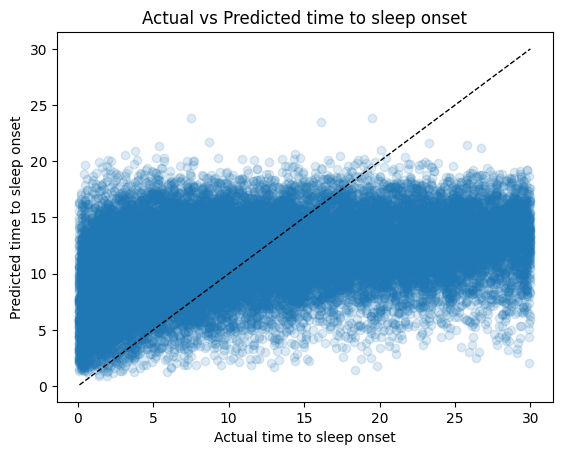

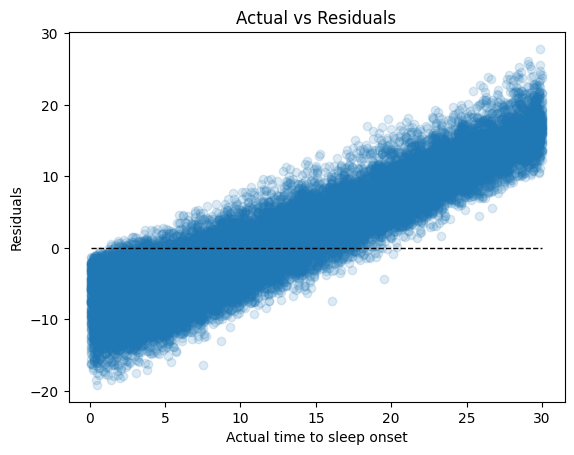

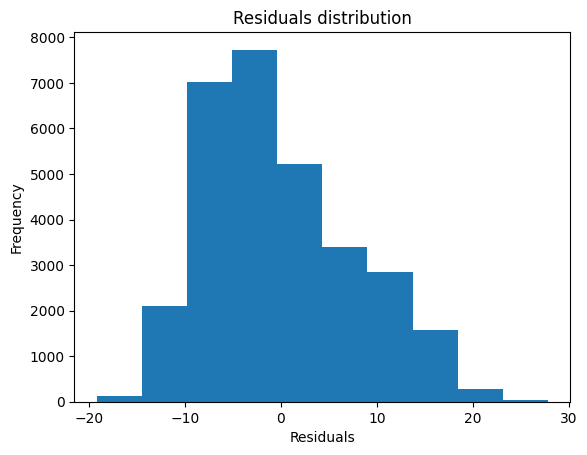

In [53]:

# Create a random forest Regressor
rf = RandomForestRegressor(n_estimators = 300)


# Perform cross-validation
predictions_cv = cross_val_predict(rf, X_train, y_train, cv=10)

# Evaluate the predictions made during cross-validation
errors, mape, accuracy, residuals, mse, rmse, r2 = evaluate_performance_train(rf, X_train, y_train, predictions_cv)




In [54]:

rf.fit(X_train, y_train)
# Predict the labels for the test set
predictions = rf.predict(X_test)

Mean Absolute Error: 6.84
Accuracy: -114.61 %.
Mean Squared Error: 67.62
Root Mean Squared Error: 8.22
R2: 0.09


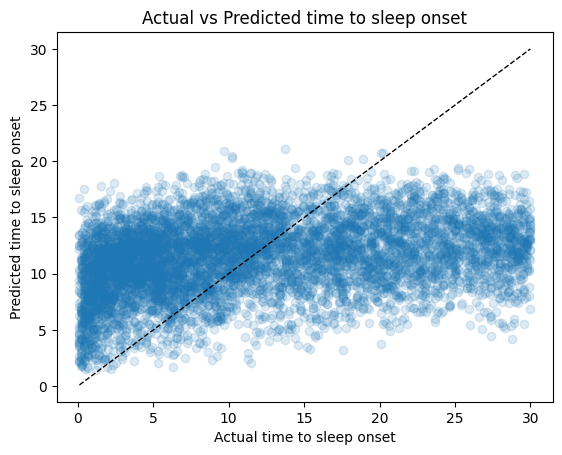

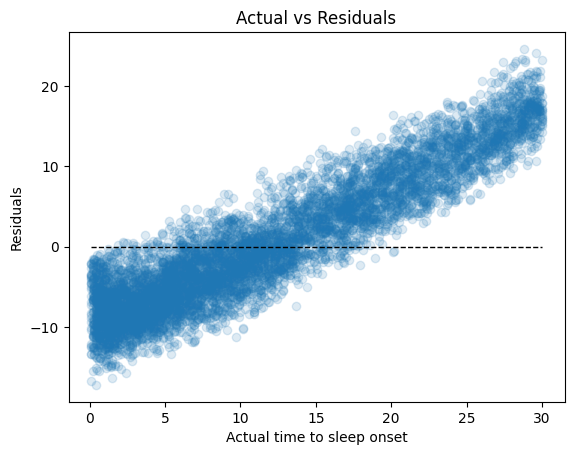

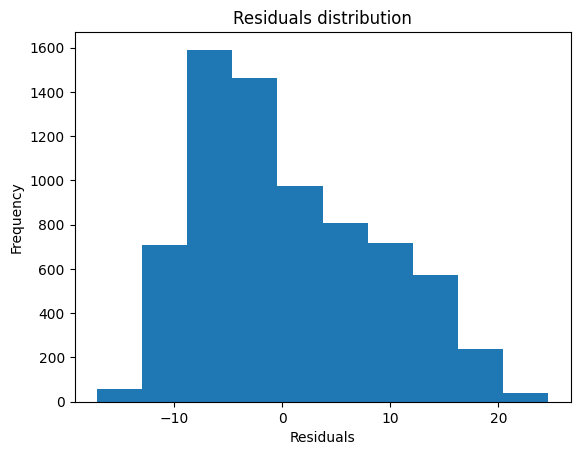

In [55]:
# evaluate the predictions made during cross-validation

errors, mape, accuracy, residuals, mse, rmse, r2 = evaluate_performance_train(rf, X_test, y_test, predictions)



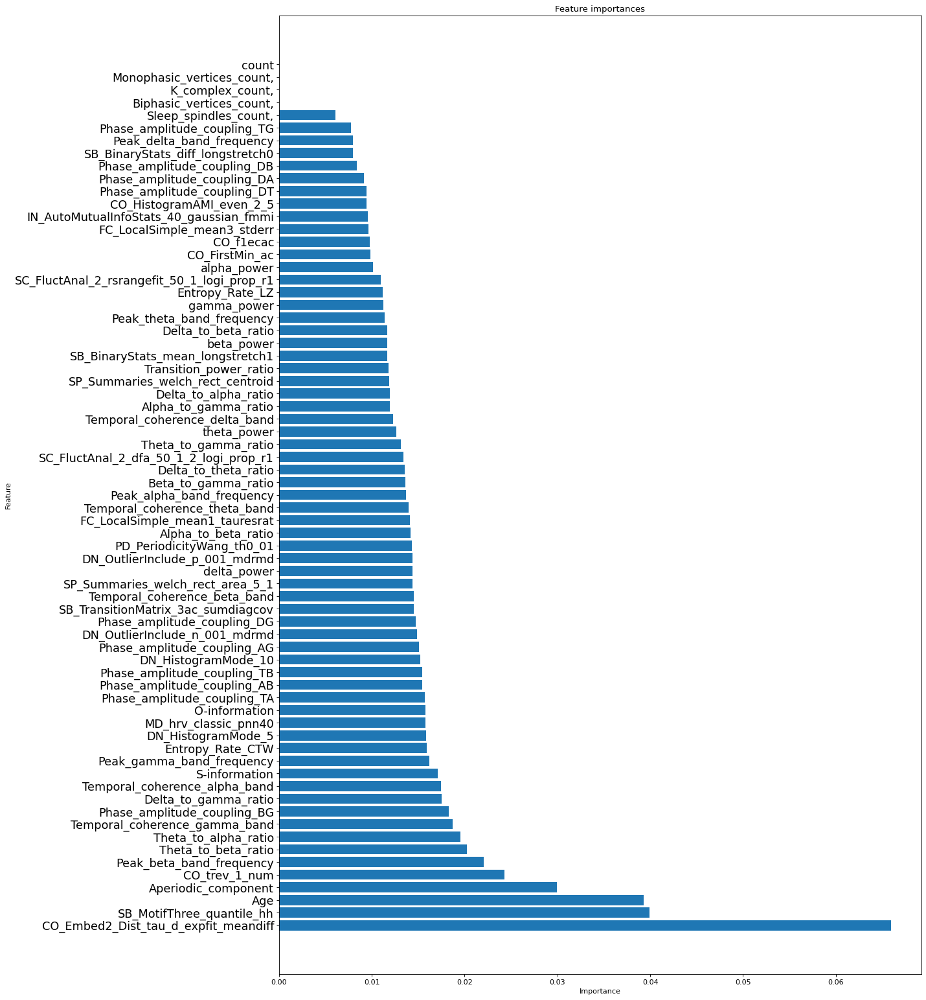

In [56]:

importances, indices, names = plot_feature_importances(rf, X_train)


## Random Forest on the clean dataset

In [57]:
# Create a new dataset only with ifCleanOnset = 1

mydata_clean_no_nan = mydata_no_nan[mydata['ifCleanOnset'] == 1]

# Create test and training sets
X_train_clean, y_train_clean, X_test_clean, y_test_clean = train_test_split_sbjs(mydata_clean_no_nan, test_size = 0.2, random_seed = 42)





/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_51866/42452539.py:3: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  mydata_clean_no_nan = mydata_no_nan[mydata['ifCleanOnset'] == 1]


Mean Absolute Error: 6.63
Accuracy: -131.69 %.
Mean Squared Error: 64.18
Root Mean Squared Error: 8.01
R2: 0.12


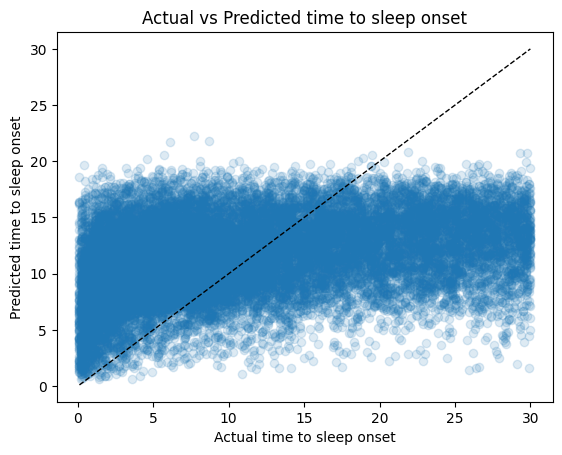

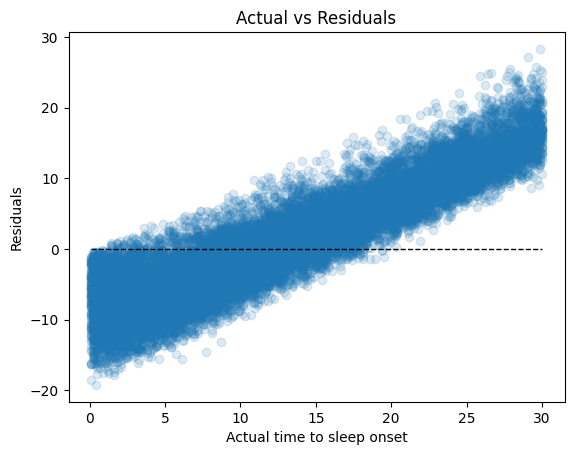

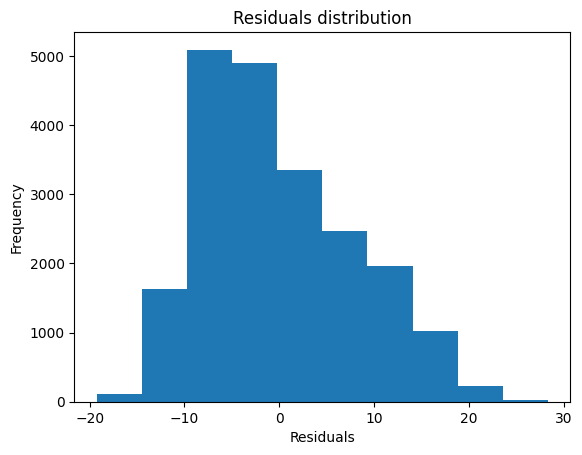

Mean Absolute Error: 6.3
Accuracy: -141.37 %.
Mean Squared Error: 58.04
Root Mean Squared Error: 7.62
R2: 0.12


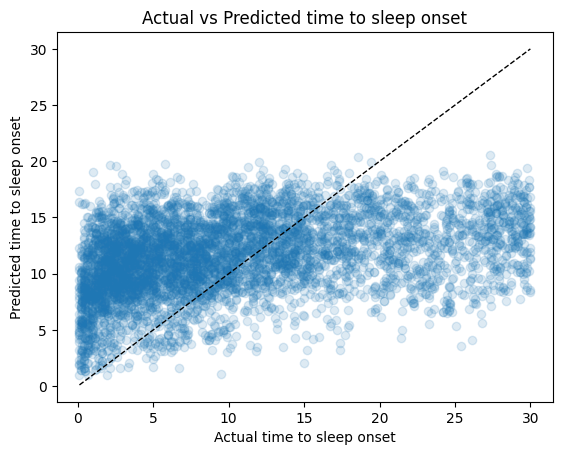

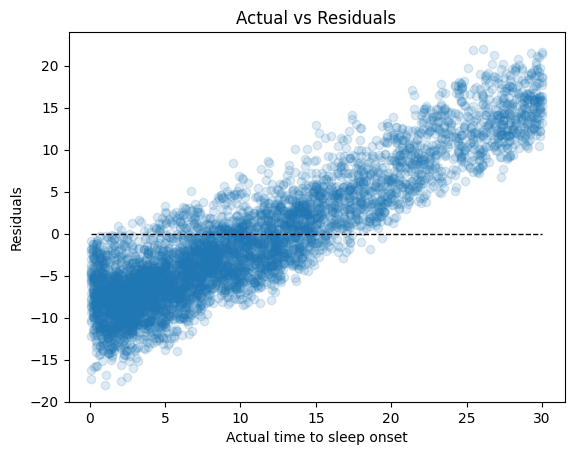

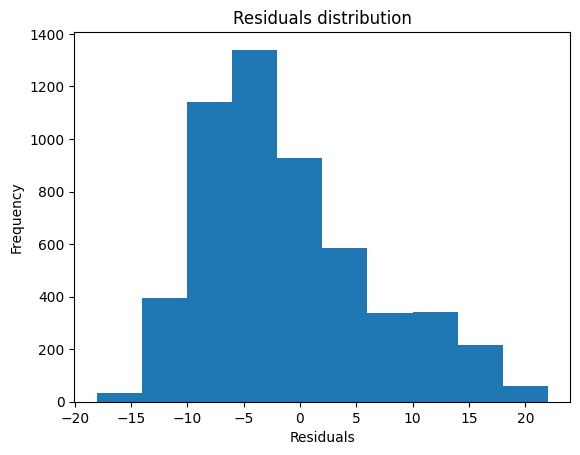

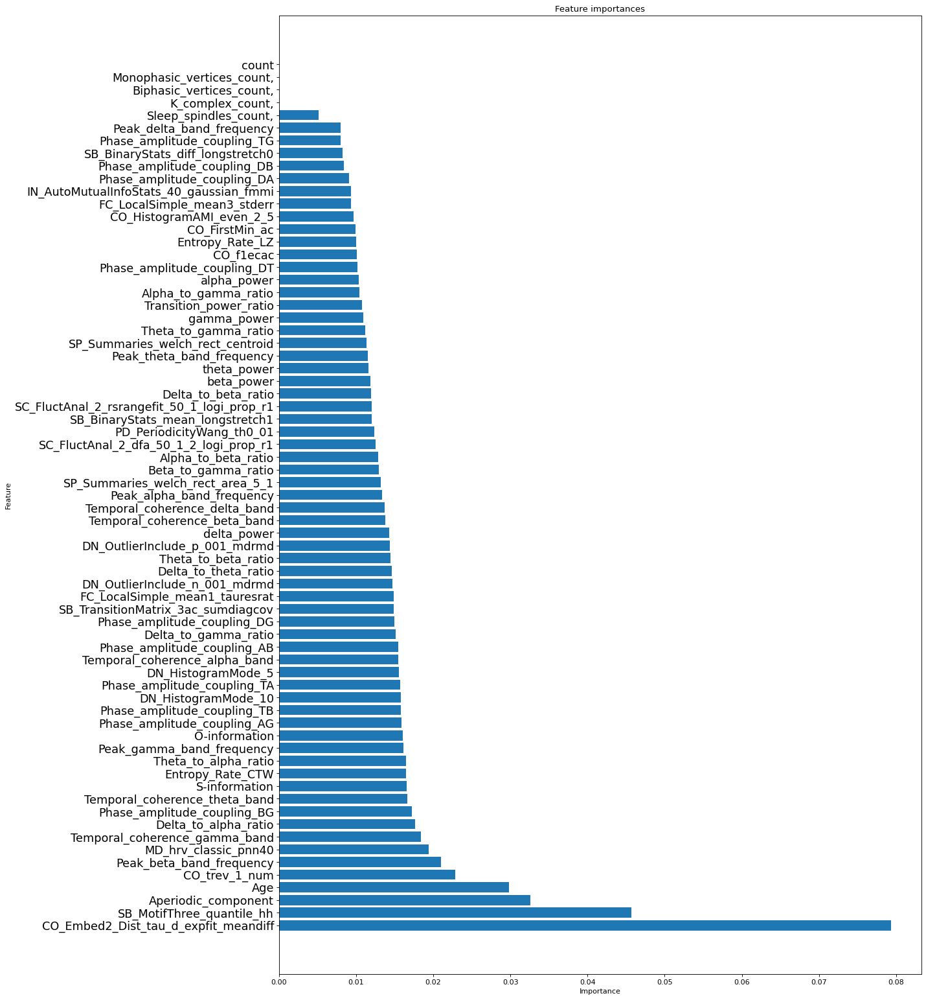

In [58]:
# Create a random forest Regressor
rf_clean = RandomForestRegressor(n_estimators = 300)

# Perform cross-validation
predictions_cv_clean = cross_val_predict(rf_clean, X_train_clean, y_train_clean, cv=10)

# Evaluate the predictions made during cross-validation
errors, mape, accuracy, residuals, mse, rmse, r2 = evaluate_performance_train(rf_clean, X_train_clean, y_train_clean, predictions_cv_clean)

rf_clean.fit(X_train_clean, y_train_clean)
# Predict the labels for the test set
predictions_clean = rf_clean.predict(X_test_clean)

# evaluate the predictions made during cross-validation

errors, mape, accuracy, residuals, mse, rmse, r2 = evaluate_performance_train(rf_clean, X_test_clean, y_test_clean, predictions_clean)

importances, indices, names = plot_feature_importances(rf_clean, X_train_clean)



In [60]:
# Repeat the same analysis for the time to sleep onset <=15 min (Label<=15)

mydata_15_no_nan = mydata_no_nan[mydata_no_nan['Label'] <= 15]

# Create test and training sets
X_train_15, y_train_15, X_test_15, y_test_15 = train_test_split_sbjs(mydata_15_no_nan, test_size = 0.2, random_seed = 42)



Mean Absolute Error: 3.31
Accuracy: -69.15 %.
Mean Squared Error: 15.46
Root Mean Squared Error: 3.93
R2: 0.1


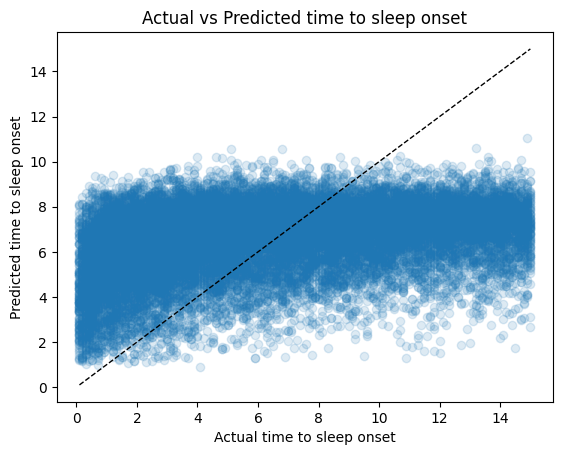

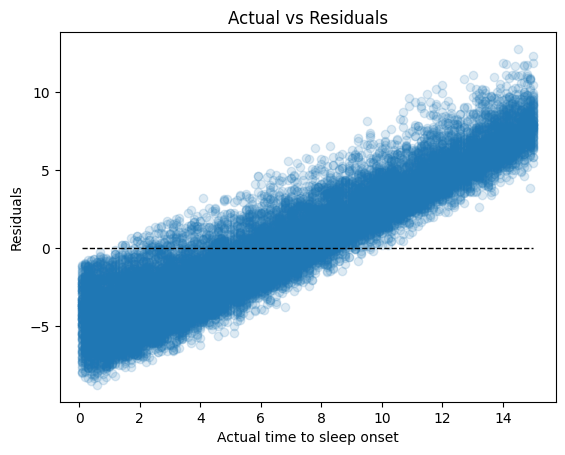

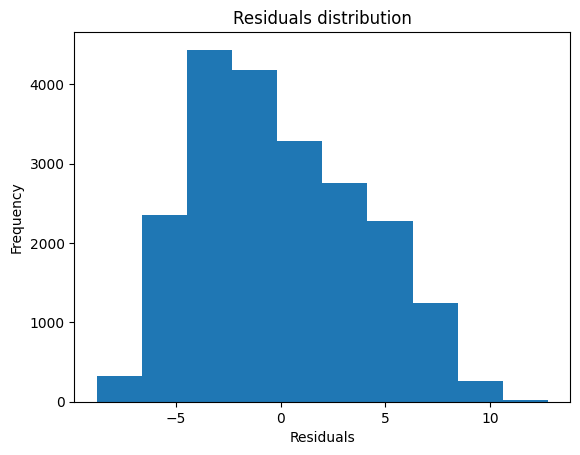

Mean Absolute Error: 3.43
Accuracy: -83.13 %.
Mean Squared Error: 16.29
Root Mean Squared Error: 4.04
R2: 0.09


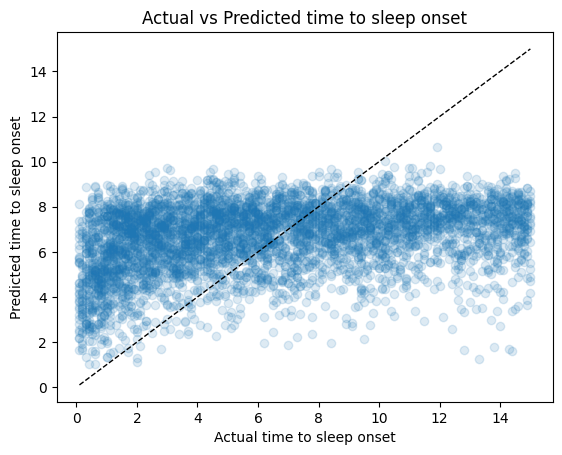

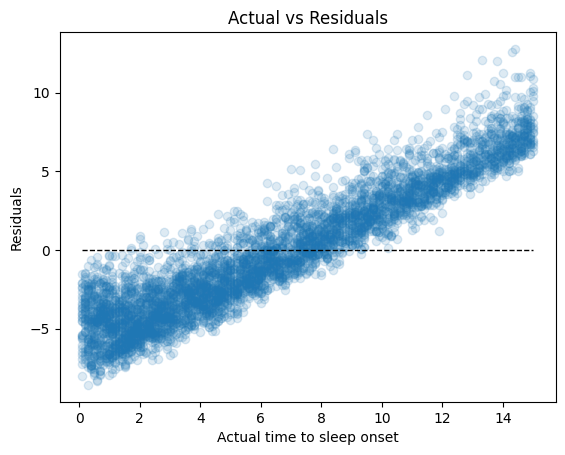

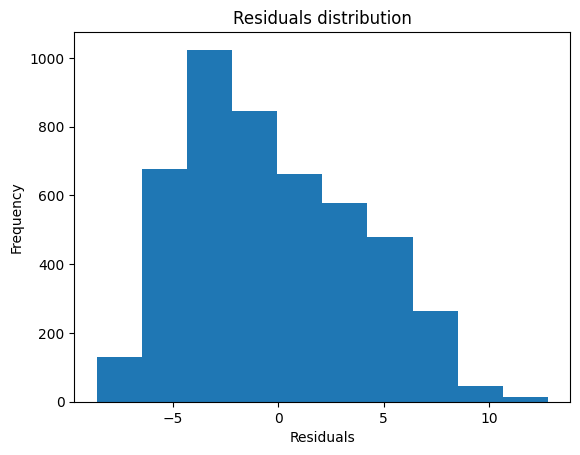

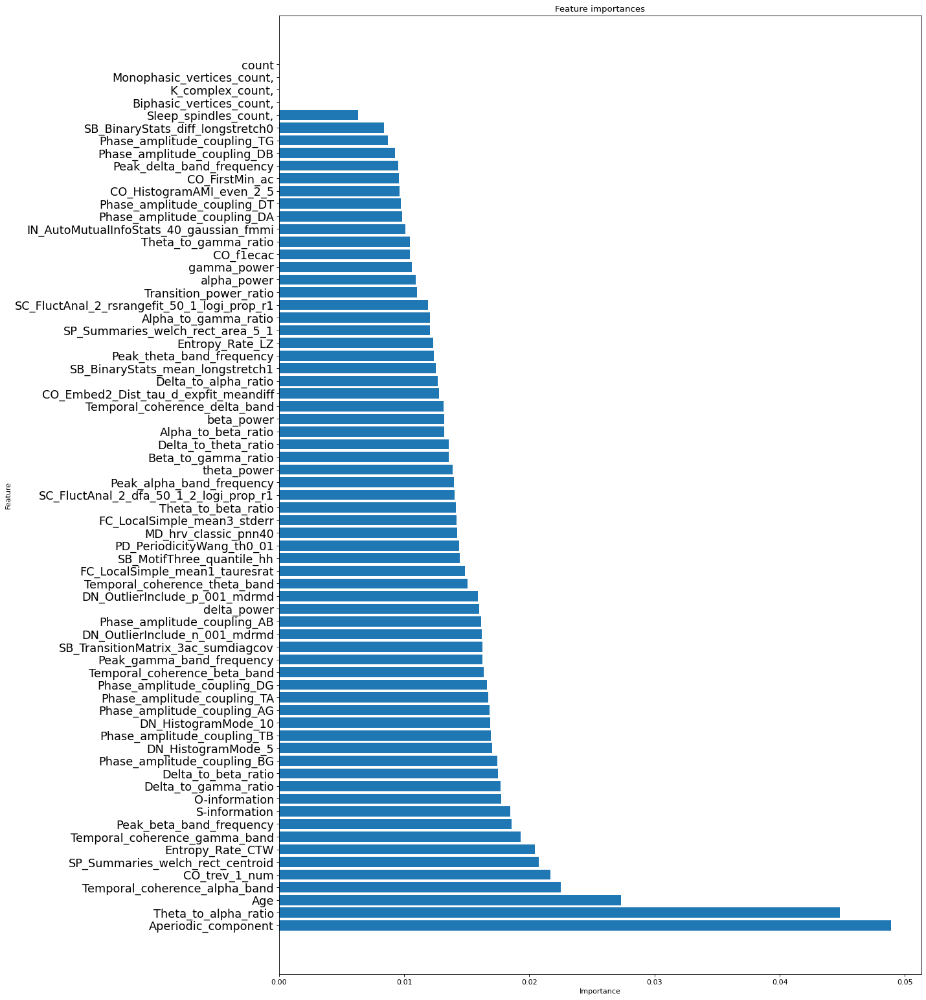

In [61]:
# Create a random forest Regressor
rf_15 = RandomForestRegressor(n_estimators = 300)

# Perform cross-validation
predictions_cv_15 = cross_val_predict(rf_15, X_train_15, y_train_15, cv=10)

# Evaluate the predictions made during cross-validation
errors, mape, accuracy, residuals, mse, rmse, r2 = evaluate_performance_train(rf_15, X_train_15, y_train_15, predictions_cv_15)
rf_15.fit(X_train_15, y_train_15)

# Predict the labels for the test set
predictions_15 = rf_15.predict(X_test_15)

# evaluate the predictions made during cross-validation using evaluate_performance_test function
errors, mape, accuracy, residuals, mse, rmse, r2 = evaluate_performance_train(rf_15, X_test_15, y_test_15, predictions_15)

importances, indices, names = plot_feature_importances(rf_15, X_train_15)


Mean Absolute Error: 2.27
Accuracy: -51.69 %.
Mean Squared Error: 7.16
Root Mean Squared Error: 2.68
R2: 0.09


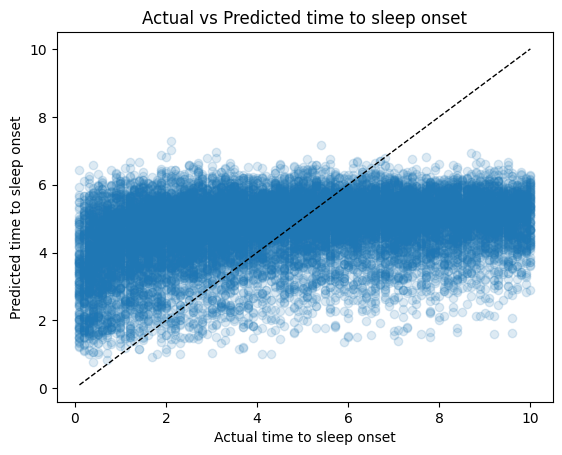

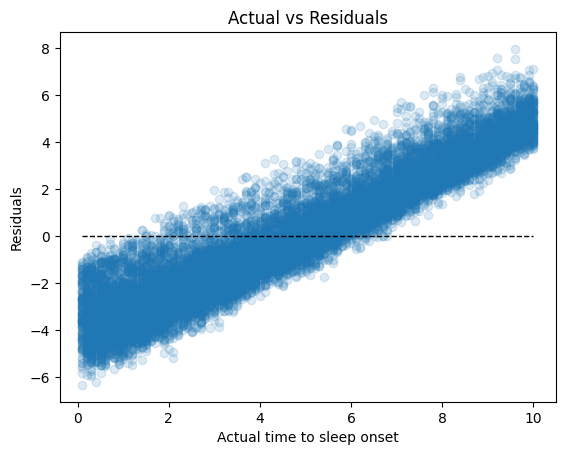

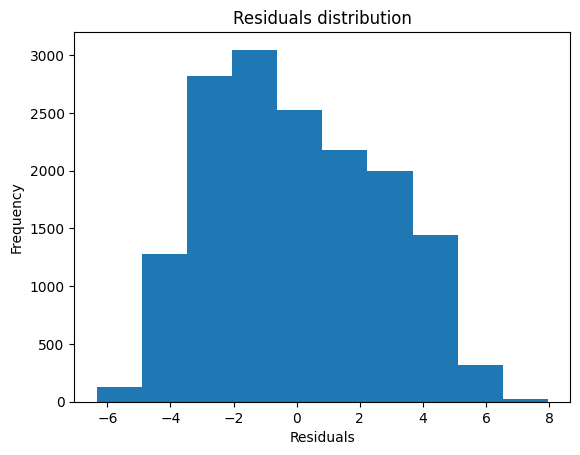

Mean Absolute Error: 2.2
Accuracy: -43.35 %.
Mean Squared Error: 6.95
Root Mean Squared Error: 2.64
R2: 0.14


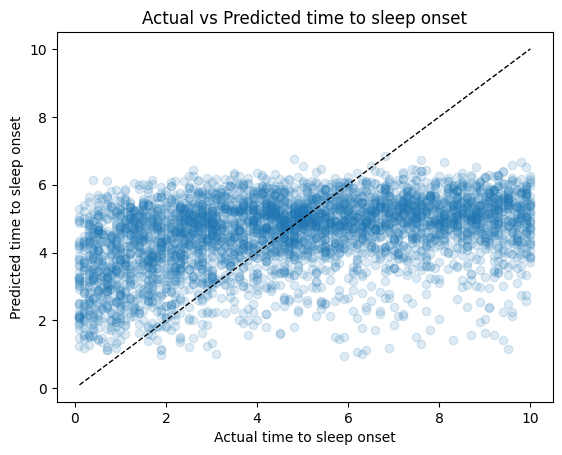

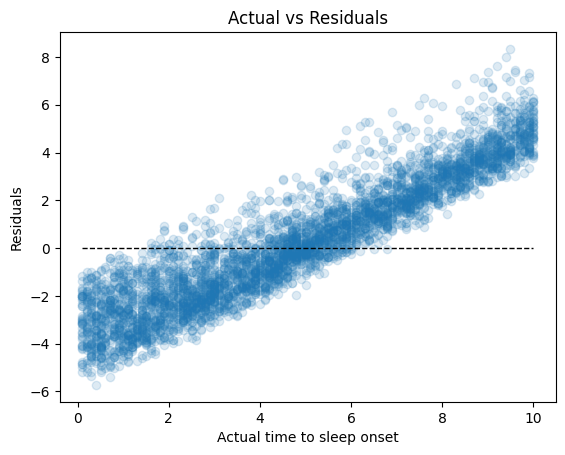

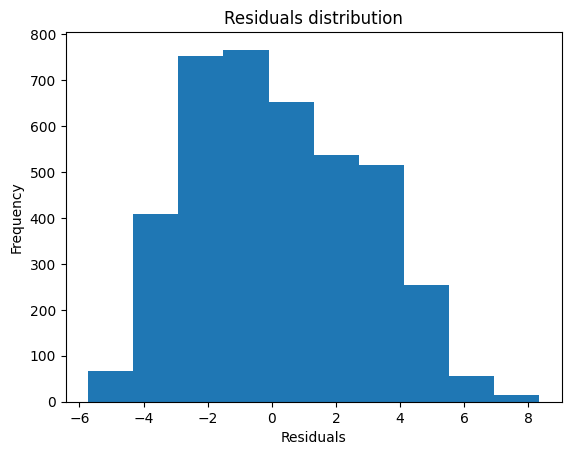

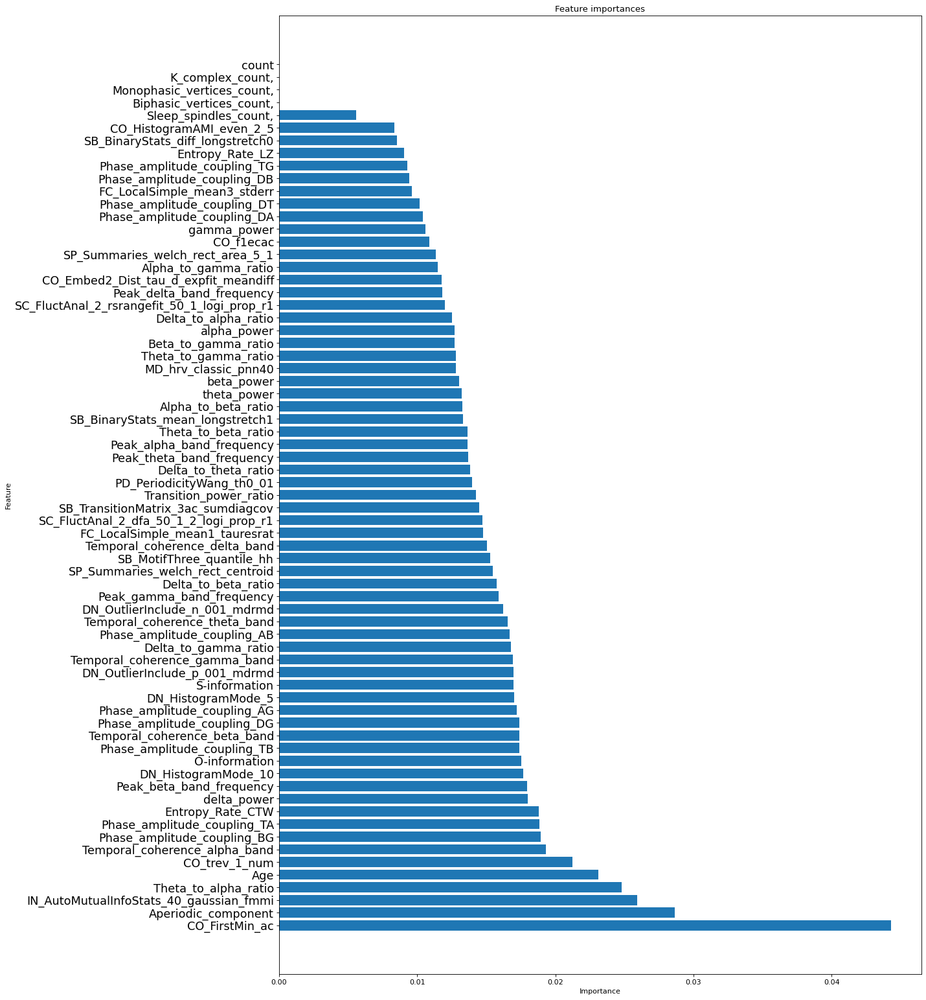

In [62]:
# Repeat the same analysis for the time to sleep onset <=10 min (Label<=10)

mydata_10_no_nan = mydata_no_nan[mydata_no_nan['Label'] <= 10]

# Create test and training sets
X_train_10, y_train_10, X_test_10, y_test_10 = train_test_split_sbjs(mydata_10_no_nan, test_size = 0.2, random_seed = 42)

# Create a random forest Regressor
rf_10 = RandomForestRegressor(n_estimators = 300)

# Perform cross-validation
predictions_cv_10 = cross_val_predict(rf_10, X_train_10, y_train_10, cv=10)

# Evaluate the predictions made during cross-validation
errors, mape, accuracy, residuals, mse, rmse, r2 = evaluate_performance_train(rf_10, X_train_10, y_train_10, predictions_cv_10)

rf_10.fit(X_train_10, y_train_10)

# Predict the labels for the test set
predictions_10 = rf_10.predict(X_test_10)

# evaluate the predictions made during cross-validation using evaluate_performance_test function
errors, mape, accuracy, residuals, mse, rmse, r2 = evaluate_performance_train(rf_10, X_test_10, y_test_10, predictions_10)

importances, indices, names = plot_feature_importances(rf_10, X_train_10)



In [32]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report

In [65]:
# take mydata and copy into  a new dataframe. in the new dataframe, switch the labels to 5 minute bins (classes '5 minutes before onset, 10 minutes before onset, 15 minutes before onset')
# and then run the model on the new dataframe

# create a new dataframe

mydata_5 = mydata_no_nan.copy()

# create a new column with the new labels

mydata_5['Label_5'] = mydata_5['Label'].apply(lambda x: 5 if x <= 5 else (10 if x <= 10 else (15 if x <= 15 else (20 if x <=20 else 25))))

# Perform a classification task on the new dataframe

# Create a dataframe with the test subjects

test_data_5 = mydata_5[mydata_5['Sbj_ID'].isin(test_subjects)]

# Create a dataframe with the train subjects

train_data_5 = mydata_5[mydata_5['Sbj_ID'].isin(train_subjects)]

# Create X and y from dataframes to use in scikit-learn (drop Label, SleepStage, Sbj_ID and ifCleanOnset columns)

X_train_5 = train_data_5.drop(['Label', 'SleepStage', 'Sbj_ID', 'ifCleanOnset', 'Label_5'], axis=1)

y_train_5 = train_data_5['Label_5']

X_test_5 = test_data_5.drop(['Label', 'SleepStage', 'Sbj_ID', 'ifCleanOnset', 'Label_5'], axis=1)

y_test_5 = test_data_5['Label_5']

# Shuffle the data

#X_train_5, y_train_5 = shuffle(X_train_5, y_train_5, random_state=0)

# Create a random forest classfier and do cross-validation

rf_5 = RandomForestClassifier(n_estimators=300)

predictions_cv = cross_val_predict(rf_5, X_train_5, y_train_5, cv=10)

Accuracy: 0.34044438609734484


Text(0.5, 23.52222222222222, 'Predicted label')

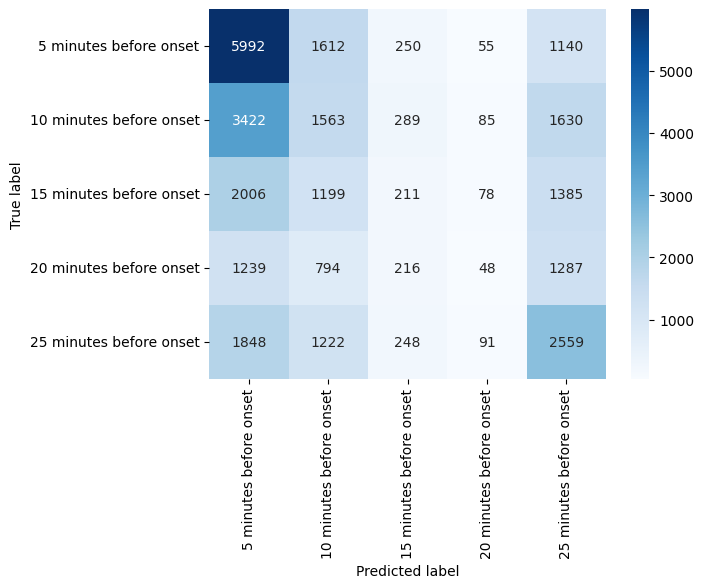

In [66]:
# evaluate the perfromance of the model

accuracy = accuracy_score(y_train_5, predictions_cv)
print(f'Accuracy: {accuracy}')

# plot the confusion matrix

# include the names of the classes in the confusion matrix
cm = confusion_matrix(y_train_5, predictions_cv)
cm_df = pd.DataFrame(cm,
                        index = ['5 minutes before onset', '10 minutes before onset', '15 minutes before onset', '20 minutes before onset', '25 minutes before onset'],
                        columns = ['5 minutes before onset', '10 minutes before onset', '15 minutes before onset', '20 minutes before onset', '25 minutes before onset'])
sns.heatmap(cm_df, annot=True, cmap='Blues', fmt='g')
plt.ylabel('True label')
plt.xlabel('Predicted label')

In [67]:
# plot the classification report

class_report = classification_report(y_train_5, predictions_cv)
print(class_report)


              precision    recall  f1-score   support

           5       0.41      0.66      0.51      9049
          10       0.24      0.22      0.23      6989
          15       0.17      0.04      0.07      4879
          20       0.13      0.01      0.02      3584
          25       0.32      0.43      0.37      5968

    accuracy                           0.34     30469
   macro avg       0.26      0.27      0.24     30469
weighted avg       0.29      0.34      0.29     30469



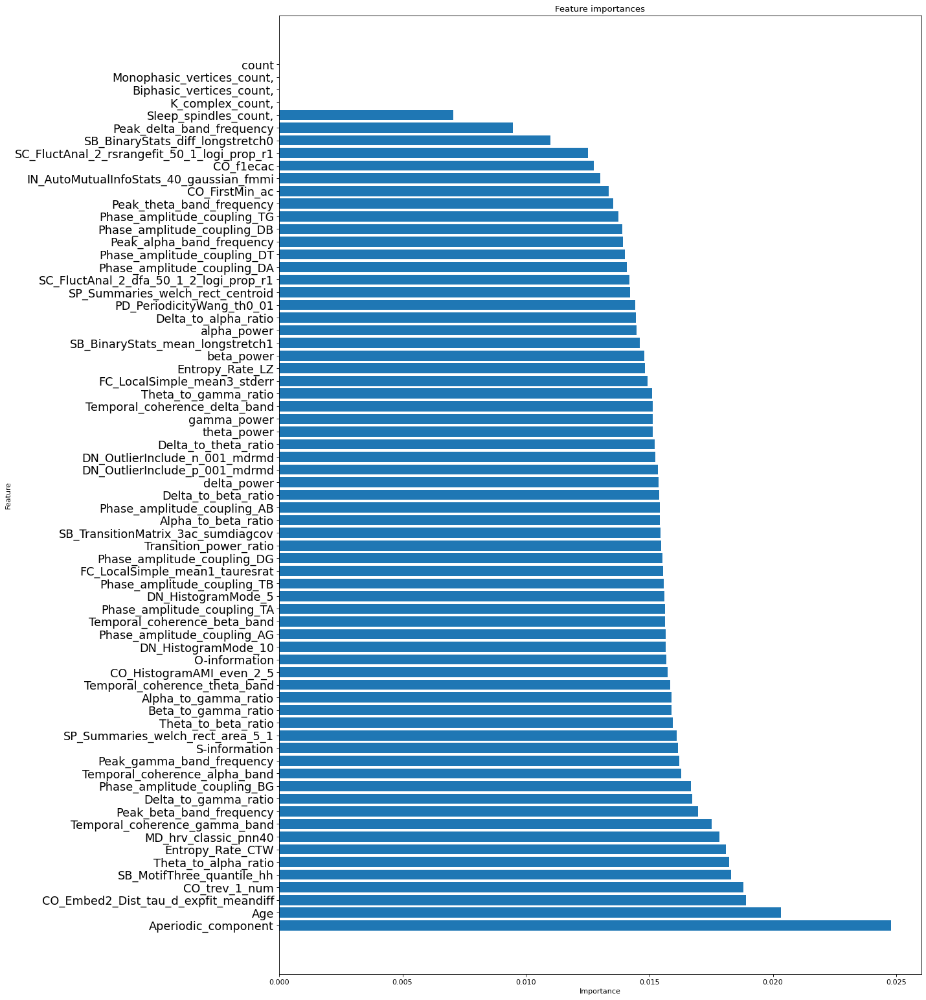

In [68]:
# Plot the feature importances
rf_5.fit(X_train_5, y_train_5)
importances_cv, indices_cv, names_cv = plot_feature_importances(rf_5, X_train_5)

In [69]:

# Predict the test data

predictions_5 = rf_5.predict(X_test_5)

#evaluate the predictions made during test 

accuracy_5 = accuracy_score(y_test_5, predictions_5)
print(f'Accuracy: {accuracy_5}')



Accuracy: 0.32957947255880254


In [70]:
# plot the confusion matrix

print(classification_report(y_test_5, predictions_5))

              precision    recall  f1-score   support

           5       0.42      0.61      0.50      2086
          10       0.29      0.24      0.26      1659
          15       0.20      0.04      0.07      1187
          20       0.12      0.01      0.02       876
          25       0.26      0.48      0.33      1207

    accuracy                           0.33      7015
   macro avg       0.26      0.28      0.24      7015
weighted avg       0.29      0.33      0.28      7015



Text(0.5, 23.52222222222222, 'Predicted label')

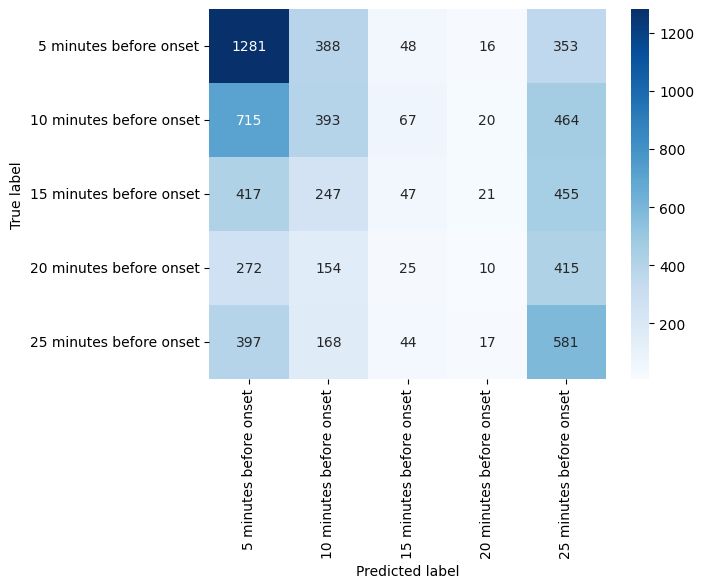

In [71]:
import seaborn as sns
import matplotlib.pyplot as plt

# include the names of the classes in the confusion matrix
cm = confusion_matrix(y_test_5, predictions_5)
cm_df = pd.DataFrame(cm,
                        index = ['5 minutes before onset', '10 minutes before onset', '15 minutes before onset', '20 minutes before onset', '25 minutes before onset'],
                        columns = ['5 minutes before onset', '10 minutes before onset', '15 minutes before onset', '20 minutes before onset', '25 minutes before onset'])
sns.heatmap(cm_df, annot=True, cmap='Blues', fmt='g')
plt.ylabel('True label')
plt.xlabel('Predicted label')

In [73]:
# import shuffle
from sklearn.utils import shuffle


In [74]:
#Create a new dataframe with the labels 10 minutes before onset and 20 minutes before onset and 30 minutes before onset

mydata_10 = mydata_no_nan.copy()

#delete rows with NaN values

mydata_10 = mydata_10.dropna()

#create a new column with the new labels

mydata_10['Label_10'] = mydata_10['Label'].apply(lambda x: 10 if x <= 10 else (20 if x <= 20 else 30))

# Perform a classification task on the new dataframe

#Create a dataframe with the test subjects

test_data_10 = mydata_10[mydata_10['Sbj_ID'].isin(test_subjects)]

#Create a dataframe with the train subjects

train_data_10 = mydata_10[mydata_10['Sbj_ID'].isin(train_subjects)]

#Create X and y from dataframes to use in scikit-learn (drop Label, SleepStage, Sbj_ID and ifCleanOnset columns)

X_train_10 = train_data_10.drop(['Label', 'SleepStage', 'Sbj_ID', 'ifCleanOnset', 'Label_10'], axis=1)

y_train_10 = train_data_10['Label_10']

X_test_10 = test_data_10.drop(['Label', 'SleepStage', 'Sbj_ID', 'ifCleanOnset', 'Label_10'], axis=1)

y_test_10 = test_data_10['Label_10']

#Shuffle the data

X_train_10, y_train_10 = shuffle(X_train_10, y_train_10, random_state=0)

#Create a random forest classfier and do cross-validation

rf_10 = RandomForestClassifier(n_estimators=300)

predictions_cv = cross_val_predict(rf_10, X_train_10, y_train_10, cv=10)




Accuracy: 0.592766418326824


Text(0.5, 23.52222222222222, 'Predicted label')

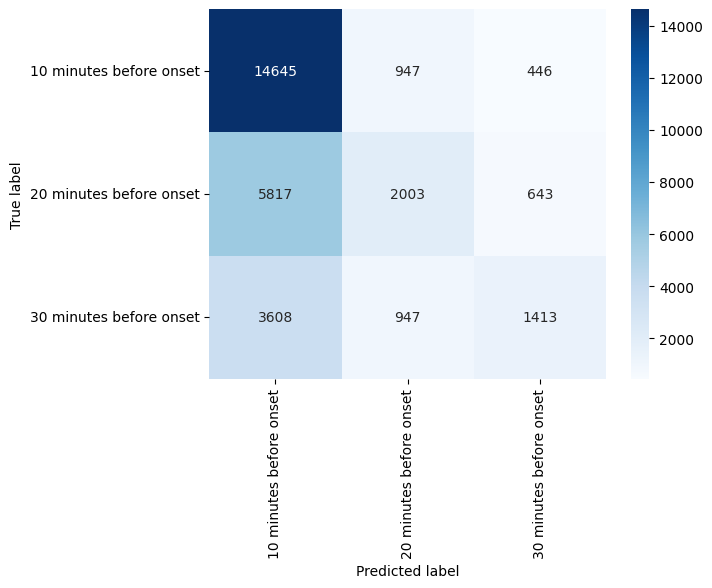

In [75]:
#evaluate the perfromance of the model

accuracy = accuracy_score(y_train_10, predictions_cv)

print(f'Accuracy: {accuracy}')

#plot the confusion matrix

# nclude the names of the classes in the confusion matrix
cm = confusion_matrix(y_train_10, predictions_cv)
cm_df = pd.DataFrame(cm,
                        index = ['10 minutes before onset', '20 minutes before onset', '30 minutes before onset'],
                        columns = ['10 minutes before onset', '20 minutes before onset', '30 minutes before onset'])
sns.heatmap(cm_df, annot=True, cmap='Blues', fmt='g')
plt.ylabel('True label')
plt.xlabel('Predicted label')



Accuracy: 0.5335709194583036
              precision    recall  f1-score   support

          10       0.59      0.86      0.70      3745
          20       0.37      0.16      0.22      2063
          30       0.30      0.17      0.22      1207

    accuracy                           0.53      7015
   macro avg       0.42      0.39      0.38      7015
weighted avg       0.47      0.53      0.47      7015



Text(0.5, 23.52222222222222, 'Predicted label')

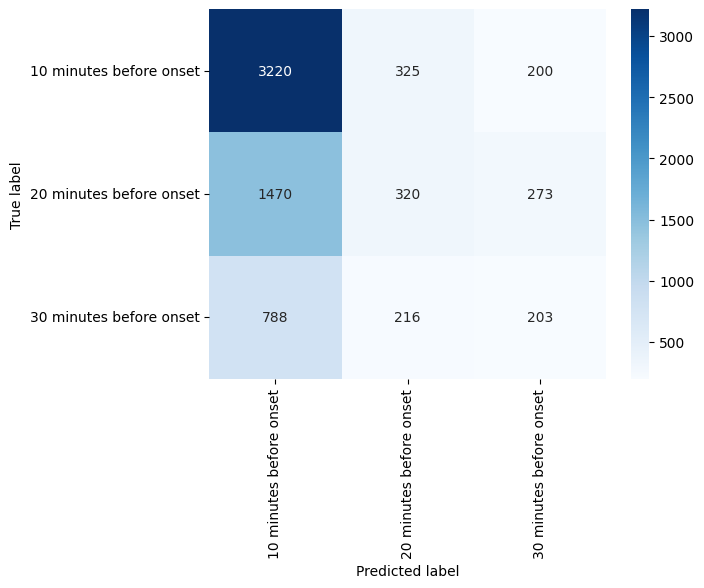

In [76]:
# try it with the test data 
rf_10.fit(X_train_10, y_train_10)
predictions_10 = rf_10.predict(X_test_10)

# evaluate the predictions made during test

accuracy_10 = accuracy_score(y_test_10, predictions_10)

print(f'Accuracy: {accuracy_10}')

# plot the confusion matrix

print(classification_report(y_test_10, predictions_10))

import seaborn as sns
import matplotlib.pyplot as plt

# include the names of the classes in the confusion matrix

cm = confusion_matrix(y_test_10, predictions_10)
cm_df = pd.DataFrame(cm,
                        index = ['10 minutes before onset', '20 minutes before onset', '30 minutes before onset'],
                        columns = ['10 minutes before onset', '20 minutes before onset', '30 minutes before onset'])
sns.heatmap(cm_df, annot=True, cmap='Blues', fmt='g')
plt.ylabel('True label')
plt.xlabel('Predicted label')


In [83]:
# Try to perfrom min-max scaling on the data per subject 

# Create a new dataframe with the labels 10 minutes before onset and 20 minutes before onset and 30 minutes before onset

mydata_10 = mydata_no_nan.copy()

# create a new column with the new labels

mydata_10['Label'] = mydata_10['Label'].apply(lambda x: 10 if x <= 10 else (20 if x <= 20 else 30))

# exclude biphasic_vertices_count and k_complex_count columns

mydata_10 = mydata_10.drop(['Biphasic_vertices_count,', 'K_complex_count,', 'Monophasic_vertices_count,', 'count'], axis=1)

# perform min-max scaling only of the features and not the labels, SleepStage, Sbj_ID and ifCleanOnset, age columns

mydata_10[mydata_10.columns[5:]] = mydata_10[mydata_10.columns[5:]].apply(lambda x: (x - x.min()) / (x.max() - x.min()))


# find nan values
mydata_10.isnull().sum()


Label                    0
Sbj_ID                   0
Age                      0
ifCleanOnset             0
SleepStage               0
                        ..
Entropy_Rate_LZ          0
Aperiodic_component      0
Sleep_spindles_count,    0
O-information            0
S-information            0
Length: 69, dtype: int64

In [84]:
# Perform a classification task on the new dataframe

# Create a dataframe with the test subjects

test_data_10 = mydata_10[mydata_10['Sbj_ID'].isin(test_subjects)]

# Create a dataframe with the train subjects

train_data_10 = mydata_10[mydata_10['Sbj_ID'].isin(train_subjects)]

# Create X and y from dataframes to use in scikit-learn (drop Label, SleepStage, Sbj_ID and ifCleanOnset columns)

X_train_10 = train_data_10.drop(['Label', 'SleepStage', 'Sbj_ID', 'ifCleanOnset', 'Label'], axis=1)

y_train_10 = train_data_10['Label']

X_test_10 = test_data_10.drop(['Label', 'SleepStage', 'Sbj_ID', 'ifCleanOnset', 'Label'], axis=1)

y_test_10 = test_data_10['Label']

# Shuffle the data

X_train_10, y_train_10 = shuffle(X_train_10, y_train_10, random_state=0)

# Create a random forest classfier and do cross-validation

rf_10 = RandomForestClassifier(n_estimators=300)

predictions_cv = cross_val_predict(rf_10, X_train_10, y_train_10, cv=10)

Accuracy: 0.5923069349174571


Text(0.5, 23.52222222222222, 'Predicted label')

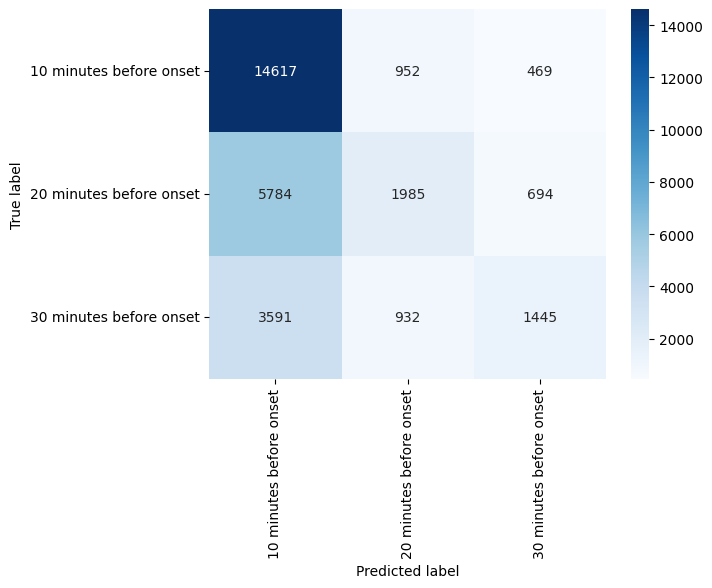

In [85]:
# evaluate the perfromance of the model

accuracy = accuracy_score(y_train_10, predictions_cv)

print(f'Accuracy: {accuracy}')

# plot the confusion matrix

# include the names of the classes in the confusion matrix
cm = confusion_matrix(y_train_10, predictions_cv)

cm_df = pd.DataFrame(cm,
                        index = ['10 minutes before onset', '20 minutes before onset', '30 minutes before onset'],
                        columns = ['10 minutes before onset', '20 minutes before onset', '30 minutes before onset'])
sns.heatmap(cm_df, annot=True, cmap='Blues', fmt='g')

plt.ylabel('True label')
plt.xlabel('Predicted label')


Accuracy: 0.5311475409836065
              precision    recall  f1-score   support

          10       0.59      0.86      0.70      3745
          20       0.37      0.15      0.21      2063
          30       0.29      0.17      0.21      1207

    accuracy                           0.53      7015
   macro avg       0.42      0.39      0.37      7015
weighted avg       0.47      0.53      0.47      7015



Text(0.5, 23.52222222222222, 'Predicted label')

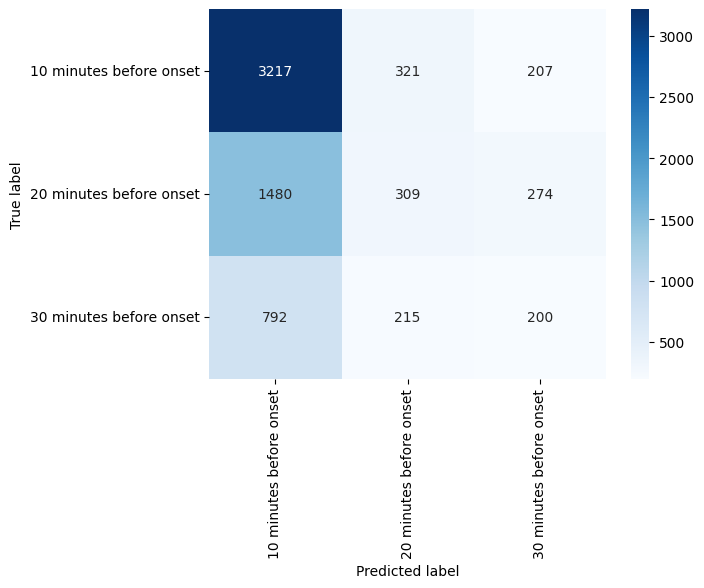

In [86]:
# try it with the test data

rf_10.fit(X_train_10, y_train_10)
predictions_10 = rf_10.predict(X_test_10)

# evaluate the predictions made during test

accuracy_10 = accuracy_score(y_test_10, predictions_10)
print(f'Accuracy: {accuracy_10}')

# plot the confusion matrix

print(classification_report(y_test_10, predictions_10))

import seaborn as sns
import matplotlib.pyplot as plt

# include the names of the classes in the confusion matrix

cm = confusion_matrix(y_test_10, predictions_10)
cm_df = pd.DataFrame(cm,
                        index = ['10 minutes before onset', '20 minutes before onset', '30 minutes before onset'],
                        columns = ['10 minutes before onset', '20 minutes before onset', '30 minutes before onset'])
sns.heatmap(cm_df, annot=True, cmap='Blues', fmt='g')
plt.ylabel('True label')
plt.xlabel('Predicted label')



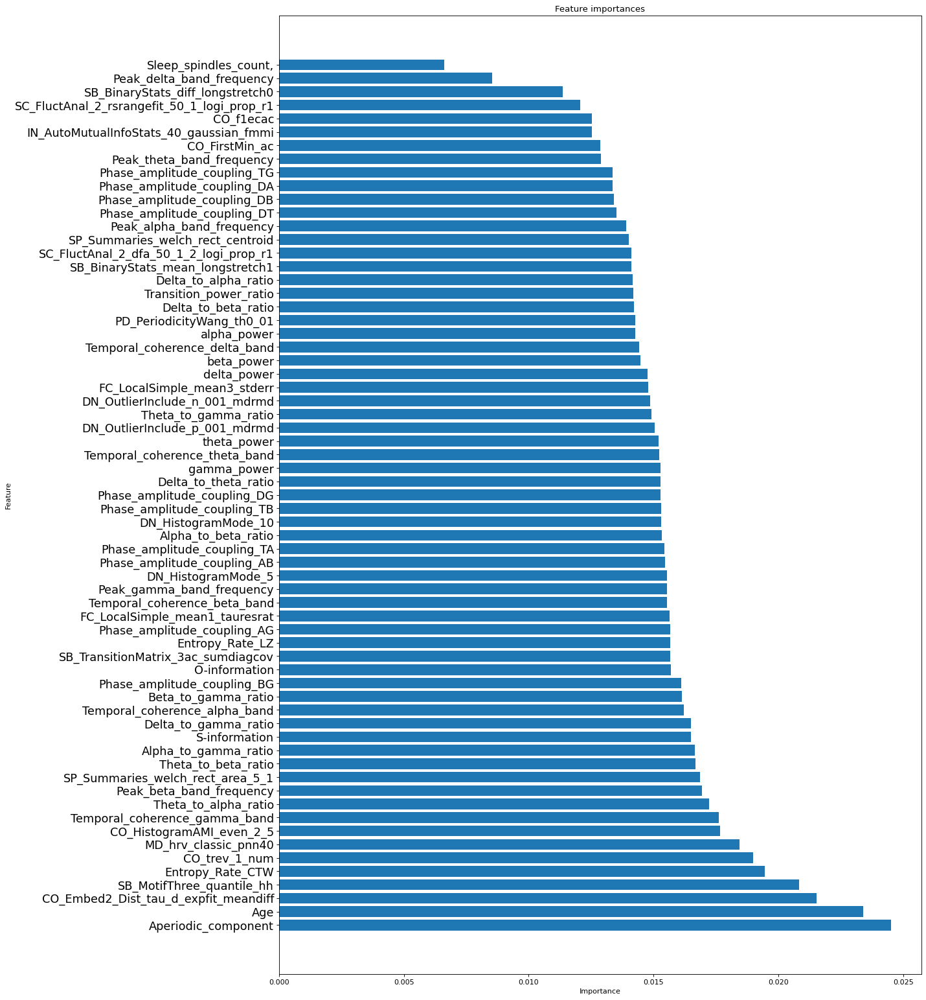

In [87]:
# plot the feature importance

importances_cv, indices_cv, names_cv = plot_feature_importances(rf_10, X_train_10)

In [30]:
from sklearn.utils import shuffle

Accuracy: 0.7520322472287537


Text(0.5, 23.52222222222222, 'Predicted label')

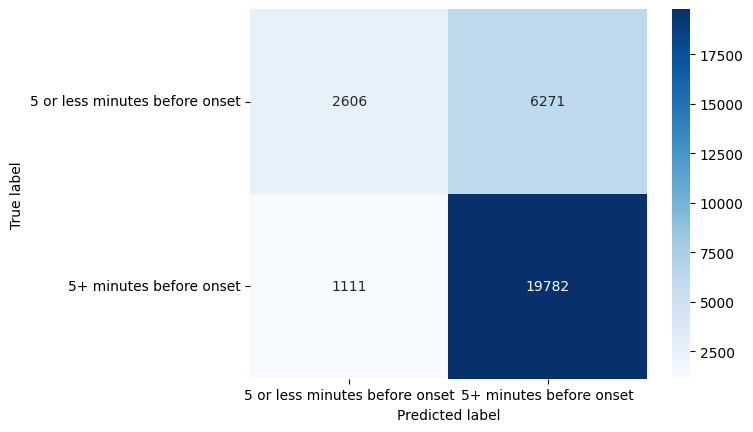

In [34]:
# Build  new dataset with less than 5 minutes before onset and more than 5 minutes before onset

# Create a new dataframe with the labels less than 5 minutes before onset and more than 5 minutes before onset

mydata_5 = mydata_no_nan.copy()

# delete rows with NaN values

mydata_5 = mydata_5.dropna()

# create a new column with the new labels

mydata_5['Label'] = mydata_5['Label'].apply(lambda x: 5 if x <= 5 else 30)

# exclude biphasic_vertices_count and k_complex_count columns

mydata_5 = mydata_5.drop(['Biphasic_vertices_count,', 'K_complex_count,', 'Monophasic_vertices_count,', 'count'], axis=1)

# perform min-max scaling only of the features and not the labels, SleepStage, Sbj_ID and ifCleanOnset, age columns

mydata_5[mydata_5.columns[5:]] = mydata_5[mydata_5.columns[5:]].apply(lambda x: (x - x.min()) / (x.max() - x.min()))



# Perform a classification task on the new dataframe

# Create a dataframe with the test subjects
# Create test and training sets
X_train_5, y_train_5, X_test_5, y_test_5 = train_test_split_sbjs(mydata_5, test_size = 0.2, random_seed = 42)

# Shuffle the data

X_train_5, y_train_5 = shuffle(X_train_5, y_train_5, random_state=0)

# Create a random forest classfier and do cross-validation

rf_5 = RandomForestClassifier(n_estimators=300)

predictions_cv = cross_val_predict(rf_5, X_train_5, y_train_5, cv=10)

# evaluate the perfromance of the model

accuracy = accuracy_score(y_train_5, predictions_cv)

print(f'Accuracy: {accuracy}')

# plot the confusion matrix

# include the names of the classes in the confusion matrix

cm = confusion_matrix(y_train_5, predictions_cv)

cm_df = pd.DataFrame(cm,
                        index = ['5 or less minutes before onset', '5+ minutes before onset'],
                        columns = ['5 or less minutes before onset', '5+ minutes before onset'])
sns.heatmap(cm_df, annot=True, cmap='Blues', fmt='g')

plt.ylabel('True label')
plt.xlabel('Predicted label')




In [35]:
# classification report

print(classification_report(y_train_5, predictions_cv))

              precision    recall  f1-score   support

           5       0.70      0.29      0.41      8877
          30       0.76      0.95      0.84     20893

    accuracy                           0.75     29770
   macro avg       0.73      0.62      0.63     29770
weighted avg       0.74      0.75      0.71     29770



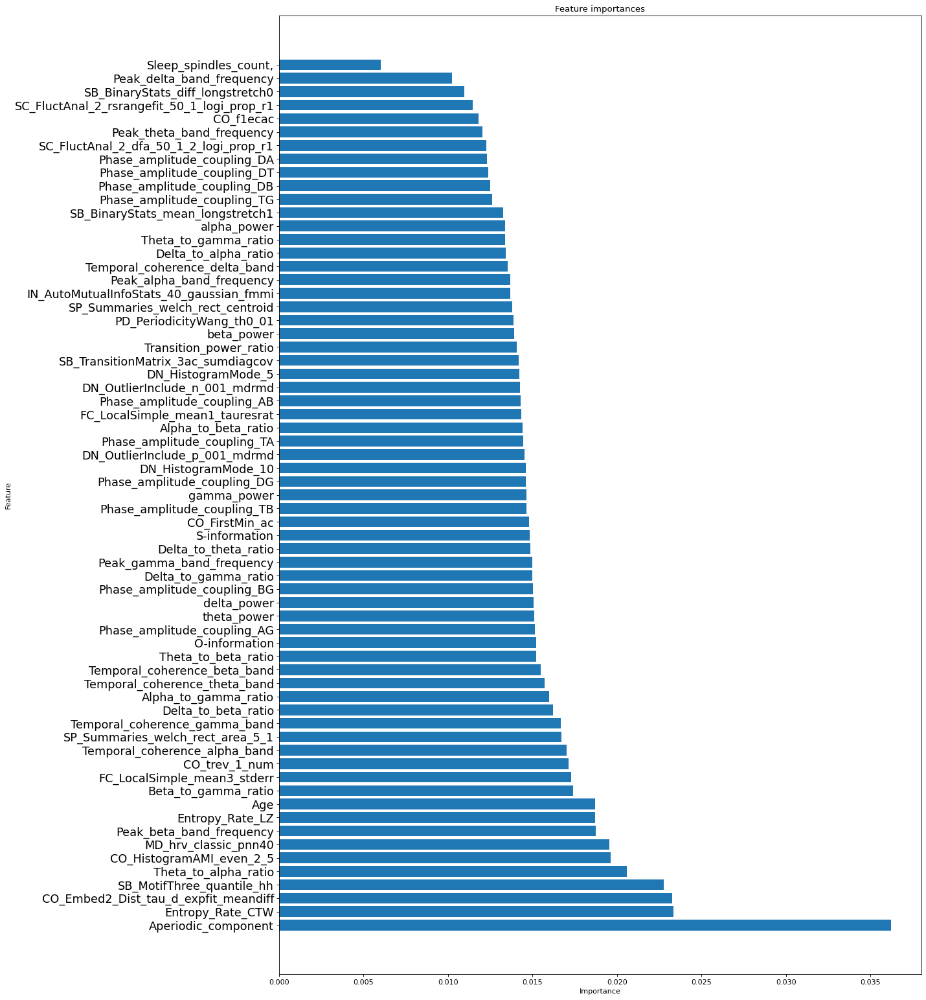

In [36]:
# fit the model with the train data

rf_5.fit(X_train_5, y_train_5)

# plot the feature importance
importances_cv, indices_cv, names_cv = plot_feature_importances(rf_5, X_train_5)



Accuracy: 0.724786103189007
              precision    recall  f1-score   support

           5       0.57      0.25      0.35      2258
          30       0.75      0.92      0.83      5456

    accuracy                           0.72      7714
   macro avg       0.66      0.59      0.59      7714
weighted avg       0.70      0.72      0.69      7714

              precision    recall  f1-score   support

           5       0.57      0.25      0.35      2258
          30       0.75      0.92      0.83      5456

    accuracy                           0.72      7714
   macro avg       0.66      0.59      0.59      7714
weighted avg       0.70      0.72      0.69      7714



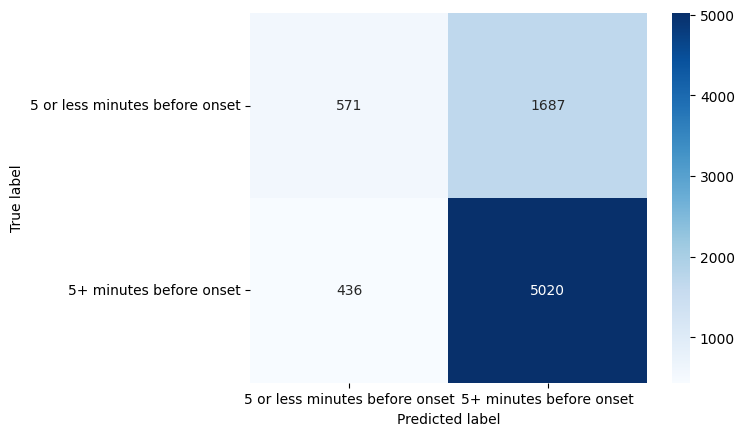

In [37]:
# predict the test data

predictions_5 = rf_5.predict(X_test_5)

# evaluate the predictions made during test

accuracy_5 = accuracy_score(y_test_5, predictions_5)
print(f'Accuracy: {accuracy_5}')

# plot the confusion matrix

print(classification_report(y_test_5, predictions_5))

import seaborn as sns
import matplotlib.pyplot as plt

# include the names of the classes in the confusion matrix

cm = confusion_matrix(y_test_5, predictions_5)

cm_df = pd.DataFrame(cm,
                        index = ['5 or less minutes before onset', '5+ minutes before onset'],      
                        columns = ['5 or less minutes before onset', '5+ minutes before onset'])
sns.heatmap(cm_df, annot=True, cmap='Blues', fmt='g')
plt.ylabel('True label')
plt.xlabel('Predicted label')


# classification report

print(classification_report(y_test_5, predictions_5))